# Afriat

In [1]:
scan=0.01

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

True

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{0.1}"
)

vae.save(
    dir_path,
    overwrite=True,
)

CUDA backend failed to initialize: Found cuDNN version 8700, but JAX was built against version 8907, which is newer. The copy of cuDNN that is installed must be at least as new as the version against which JAX was built. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_figures
ID: y75jsv53
Name: worldly-wind-110
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_figures/runs/y75jsv53
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240503_101835-y75jsv53/files



GPU available: True (cuda), used: True


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


You are using a CUDA device ('NVIDIA A100 80GB PCIe') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "
SLURM auto-requeueing enabled. Setting signal handlers.


Training:   0%|                                                                                                                                                                                                                                | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|                                                                                                                                                                                                                             | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2595,3280,9368
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2595,2553,1653,3417,1636,3389
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4472,10771
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 610,829,2371
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 610,649,455,873,413,810
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1112,2698
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|▎                                                                                                                                                                                                                  | 1/600 [00:11<1:54:20, 11.45s/it]

Epoch 1/600:   0%|▎                                                                                                                                                       | 1/600 [00:11<1:54:20, 11.45s/it, v_num=53_1, total_loss_train=3.71e+3, kl_local_train=42.9]

Epoch 2/600:   0%|▎                                                                                                                                                       | 1/600 [00:11<1:54:20, 11.45s/it, v_num=53_1, total_loss_train=3.71e+3, kl_local_train=42.9]

Epoch 2/600:   0%|▌                                                                                                                                                       | 2/600 [00:16<1:18:05,  7.84s/it, v_num=53_1, total_loss_train=3.71e+3, kl_local_train=42.9]

Epoch 2/600:   0%|▌                                                                                                                                                       | 2/600 [00:16<1:18:05,  7.84s/it, v_num=53_1, total_loss_train=3.23e+3, kl_local_train=58.6]

Epoch 3/600:   0%|▌                                                                                                                                                       | 2/600 [00:16<1:18:05,  7.84s/it, v_num=53_1, total_loss_train=3.23e+3, kl_local_train=58.6]

Epoch 3/600:   0%|▊                                                                                                                                                       | 3/600 [00:22<1:06:14,  6.66s/it, v_num=53_1, total_loss_train=3.23e+3, kl_local_train=58.6]

Epoch 3/600:   0%|▊                                                                                                                                                       | 3/600 [00:22<1:06:14,  6.66s/it, v_num=53_1, total_loss_train=3.22e+3, kl_local_train=56.6]

Epoch 4/600:   0%|▊                                                                                                                                                       | 3/600 [00:22<1:06:14,  6.66s/it, v_num=53_1, total_loss_train=3.22e+3, kl_local_train=56.6]

Epoch 4/600:   1%|█                                                                                                                                                       | 4/600 [00:27<1:00:35,  6.10s/it, v_num=53_1, total_loss_train=3.22e+3, kl_local_train=56.6]

Epoch 4/600:   1%|█                                                                                                                                                       | 4/600 [00:27<1:00:35,  6.10s/it, v_num=53_1, total_loss_train=3.22e+3, kl_local_train=51.3]

Epoch 5/600:   1%|█                                                                                                                                                       | 4/600 [00:27<1:00:35,  6.10s/it, v_num=53_1, total_loss_train=3.22e+3, kl_local_train=51.3]

Epoch 5/600:   1%|█▎                                                                                                                                                        | 5/600 [00:32<57:22,  5.79s/it, v_num=53_1, total_loss_train=3.22e+3, kl_local_train=51.3]

Epoch 5/600:   1%|█▎                                                                                                                                                        | 5/600 [00:32<57:22,  5.79s/it, v_num=53_1, total_loss_train=3.22e+3, kl_local_train=39.3]

Epoch 6/600:   1%|█▎                                                                                                                                                        | 5/600 [00:33<57:22,  5.79s/it, v_num=53_1, total_loss_train=3.22e+3, kl_local_train=39.3]

Epoch 6/600:   1%|█▌                                                                                                                                                        | 6/600 [00:38<58:38,  5.92s/it, v_num=53_1, total_loss_train=3.22e+3, kl_local_train=39.3]

Epoch 6/600:   1%|▎                        | 6/600 [00:38<58:38,  5.92s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=34.7, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0143, metric_mi|mouse_train=0.037]

Epoch 7/600:   1%|▎                        | 6/600 [00:38<58:38,  5.92s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=34.7, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0143, metric_mi|mouse_train=0.037]

Epoch 7/600:   1%|▎                        | 7/600 [00:43<56:09,  5.68s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=34.7, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0143, metric_mi|mouse_train=0.037]

Epoch 7/600:   1%|▎                        | 7/600 [00:43<56:09,  5.68s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=32.9, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0143, metric_mi|mouse_train=0.037]

Epoch 8/600:   1%|▎                        | 7/600 [00:43<56:09,  5.68s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=32.9, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0143, metric_mi|mouse_train=0.037]

Epoch 8/600:   1%|▎                        | 8/600 [00:49<54:29,  5.52s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=32.9, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0143, metric_mi|mouse_train=0.037]

Epoch 8/600:   1%|▎                        | 8/600 [00:49<54:29,  5.52s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=28.8, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0143, metric_mi|mouse_train=0.037]

Epoch 9/600:   1%|▎                        | 8/600 [00:49<54:29,  5.52s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=28.8, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0143, metric_mi|mouse_train=0.037]

Epoch 9/600:   2%|▍                        | 9/600 [00:54<53:22,  5.42s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=28.8, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0143, metric_mi|mouse_train=0.037]

Epoch 9/600:   2%|▍                        | 9/600 [00:54<53:22,  5.42s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=29.5, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0143, metric_mi|mouse_train=0.037]

Epoch 10/600:   2%|▎                       | 9/600 [00:54<53:22,  5.42s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=29.5, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0143, metric_mi|mouse_train=0.037]

Epoch 10/600:   2%|▍                      | 10/600 [00:59<52:32,  5.34s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=29.5, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0143, metric_mi|mouse_train=0.037]

Epoch 10/600:   2%|▍                      | 10/600 [00:59<52:32,  5.34s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=31.7, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0143, metric_mi|mouse_train=0.037]

Epoch 11/600:   2%|▍                      | 10/600 [01:00<52:32,  5.34s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=31.7, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0143, metric_mi|mouse_train=0.037]

Epoch 11/600:   2%|▍                      | 11/600 [01:05<54:54,  5.59s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=31.7, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0143, metric_mi|mouse_train=0.037]

Epoch 11/600:   2%|▍                      | 11/600 [01:05<54:54,  5.59s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=37, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0597]

Epoch 12/600:   2%|▍                      | 11/600 [01:05<54:54,  5.59s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=37, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0597]

Epoch 12/600:   2%|▍                      | 12/600 [01:10<53:30,  5.46s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=37, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0597]

Epoch 12/600:   2%|▍                    | 12/600 [01:10<53:30,  5.46s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0597]

Epoch 13/600:   2%|▍                    | 12/600 [01:10<53:30,  5.46s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0597]

Epoch 13/600:   2%|▍                    | 13/600 [01:15<52:35,  5.38s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0597]

Epoch 13/600:   2%|▍                    | 13/600 [01:15<52:35,  5.38s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0597]

Epoch 14/600:   2%|▍                    | 13/600 [01:15<52:35,  5.38s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0597]

Epoch 14/600:   2%|▍                    | 14/600 [01:21<51:54,  5.32s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0597]

Epoch 14/600:   2%|▍                    | 14/600 [01:21<51:54,  5.32s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0597]

Epoch 15/600:   2%|▍                    | 14/600 [01:21<51:54,  5.32s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0597]

Epoch 15/600:   2%|▌                    | 15/600 [01:26<51:24,  5.27s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0597]

Epoch 15/600:   2%|▌                    | 15/600 [01:26<51:24,  5.27s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0597]

Epoch 16/600:   2%|▌                    | 15/600 [01:27<51:24,  5.27s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0597]

Epoch 16/600:   3%|▌                    | 16/600 [01:32<53:56,  5.54s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0597]

Epoch 16/600:   3%|▌                    | 16/600 [01:32<53:56,  5.54s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0751]

Epoch 17/600:   3%|▌                    | 16/600 [01:32<53:56,  5.54s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0751]

Epoch 17/600:   3%|▌                    | 17/600 [01:37<52:43,  5.43s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0751]

Epoch 17/600:   3%|▌                    | 17/600 [01:37<52:43,  5.43s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0751]

Epoch 18/600:   3%|▌                    | 17/600 [01:37<52:43,  5.43s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0751]

Epoch 18/600:   3%|▋                    | 18/600 [01:42<51:57,  5.36s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0751]

Epoch 18/600:   3%|▋                    | 18/600 [01:42<51:57,  5.36s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0751]

Epoch 19/600:   3%|▋                    | 18/600 [01:42<51:57,  5.36s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0751]

Epoch 19/600:   3%|▋                    | 19/600 [01:48<51:34,  5.33s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0751]

Epoch 19/600:   3%|▋                    | 19/600 [01:48<51:34,  5.33s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=56.4, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0751]

Epoch 20/600:   3%|▋                    | 19/600 [01:48<51:34,  5.33s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=56.4, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0751]

Epoch 20/600:   3%|▋                    | 20/600 [01:53<51:03,  5.28s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=56.4, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0751]

Epoch 20/600:   3%|▊                      | 20/600 [01:53<51:03,  5.28s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=59, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0751]

Epoch 21/600:   3%|▊                      | 20/600 [01:54<51:03,  5.28s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=59, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0751]

Epoch 21/600:   4%|▊                      | 21/600 [01:59<53:32,  5.55s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=59, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0751]

Epoch 21/600:   4%|▋                    | 21/600 [01:59<53:32,  5.55s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=61.3, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0273, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0732]

Epoch 22/600:   4%|▋                    | 21/600 [01:59<53:32,  5.55s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=61.3, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0273, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0732]

Epoch 22/600:   4%|▊                    | 22/600 [02:04<52:21,  5.44s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=61.3, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0273, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0732]

Epoch 22/600:   4%|▊                    | 22/600 [02:04<52:21,  5.44s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=63.5, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0273, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0732]

Epoch 23/600:   4%|▊                    | 22/600 [02:04<52:21,  5.44s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=63.5, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0273, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0732]

Epoch 23/600:   4%|▊                    | 23/600 [02:09<51:33,  5.36s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=63.5, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0273, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0732]

Epoch 23/600:   4%|▊                    | 23/600 [02:09<51:33,  5.36s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=65.7, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0273, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0732]

Epoch 24/600:   4%|▊                    | 23/600 [02:09<51:33,  5.36s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=65.7, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0273, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0732]

Epoch 24/600:   4%|▊                    | 24/600 [02:14<51:01,  5.31s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=65.7, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0273, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0732]

Epoch 24/600:   4%|▊                    | 24/600 [02:14<51:01,  5.31s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=67.6, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0273, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0732]

Epoch 25/600:   4%|▊                    | 24/600 [02:14<51:01,  5.31s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=67.6, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0273, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0732]

Epoch 25/600:   4%|▉                    | 25/600 [02:20<50:37,  5.28s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=67.6, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0273, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0732]

Epoch 25/600:   4%|▉                    | 25/600 [02:20<50:37,  5.28s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=69.3, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0273, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0732]

Epoch 26/600:   4%|▉                    | 25/600 [02:21<50:37,  5.28s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=69.3, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0273, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0732]

Epoch 26/600:   4%|▉                    | 26/600 [02:26<53:18,  5.57s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=69.3, metric_mi|status_control_train=0.0323, metric_mi|zone_train=0.0273, metric_mi|time_cat_train=0.0471, metric_mi|mouse_train=0.0732]

Epoch 26/600:   4%|▉                    | 26/600 [02:26<53:18,  5.57s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=70.6, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0688]

Epoch 27/600:   4%|▉                    | 26/600 [02:26<53:18,  5.57s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=70.6, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0688]

Epoch 27/600:   4%|▉                    | 27/600 [02:31<52:08,  5.46s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=70.6, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0688]

Epoch 27/600:   4%|▉                    | 27/600 [02:31<52:08,  5.46s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=73.8, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0688]

Epoch 28/600:   4%|▉                    | 27/600 [02:31<52:08,  5.46s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=73.8, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0688]

Epoch 28/600:   5%|▉                    | 28/600 [02:36<51:29,  5.40s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=73.8, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0688]

Epoch 28/600:   5%|▉                    | 28/600 [02:36<51:29,  5.40s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=77.1, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0688]

Epoch 29/600:   5%|▉                    | 28/600 [02:36<51:29,  5.40s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=77.1, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0688]

Epoch 29/600:   5%|█                    | 29/600 [02:42<50:43,  5.33s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=77.1, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0688]

Epoch 29/600:   5%|█                    | 29/600 [02:42<50:43,  5.33s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=78.7, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0688]

Epoch 30/600:   5%|█                    | 29/600 [02:42<50:43,  5.33s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=78.7, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0688]

Epoch 30/600:   5%|█                    | 30/600 [02:47<50:19,  5.30s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=78.7, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0688]

Epoch 30/600:   5%|█                    | 30/600 [02:47<50:19,  5.30s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=76.9, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0688]

Epoch 31/600:   5%|█                    | 30/600 [02:48<50:19,  5.30s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=76.9, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0688]

Epoch 31/600:   5%|█                    | 31/600 [02:53<52:41,  5.56s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=76.9, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0227, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0688]

Epoch 31/600:   5%|█                    | 31/600 [02:53<52:41,  5.56s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=76.8, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0648]

Epoch 32/600:   5%|█                    | 31/600 [02:53<52:41,  5.56s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=76.8, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0648]

Epoch 32/600:   5%|█                    | 32/600 [02:58<51:28,  5.44s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=76.8, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0648]

Epoch 32/600:   5%|█                    | 32/600 [02:58<51:28,  5.44s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=79.1, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0648]

Epoch 33/600:   5%|█                    | 32/600 [02:58<51:28,  5.44s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=79.1, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0648]

Epoch 33/600:   6%|█▏                   | 33/600 [03:03<50:38,  5.36s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=79.1, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0648]

Epoch 33/600:   6%|█▏                   | 33/600 [03:03<50:38,  5.36s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=80.8, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0648]

Epoch 34/600:   6%|█▏                   | 33/600 [03:03<50:38,  5.36s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=80.8, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0648]

Epoch 34/600:   6%|█▏                   | 34/600 [03:08<49:59,  5.30s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=80.8, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0648]

Epoch 34/600:   6%|█▏                   | 34/600 [03:08<49:59,  5.30s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=81.9, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0648]

Epoch 35/600:   6%|█▏                   | 34/600 [03:08<49:59,  5.30s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=81.9, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0648]

Epoch 35/600:   6%|█▏                   | 35/600 [03:14<49:38,  5.27s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=81.9, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0648]

Epoch 35/600:   6%|█▏                   | 35/600 [03:14<49:38,  5.27s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=82.3, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0648]

Epoch 36/600:   6%|█▏                   | 35/600 [03:15<49:38,  5.27s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=82.3, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0648]

Epoch 36/600:   6%|█▎                   | 36/600 [03:20<52:01,  5.53s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=82.3, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0189, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0648]

Epoch 36/600:   6%|█▎                    | 36/600 [03:20<52:01,  5.53s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=82.1, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0176, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.063]

Epoch 37/600:   6%|█▎                    | 36/600 [03:20<52:01,  5.53s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=82.1, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0176, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.063]

Epoch 37/600:   6%|█▎                    | 37/600 [03:25<50:52,  5.42s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=82.1, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0176, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.063]

Epoch 37/600:   6%|█▎                    | 37/600 [03:25<50:52,  5.42s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=79.7, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0176, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.063]

Epoch 38/600:   6%|█▎                    | 37/600 [03:25<50:52,  5.42s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=79.7, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0176, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.063]

Epoch 38/600:   6%|█▍                    | 38/600 [03:30<50:03,  5.34s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=79.7, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0176, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.063]

Epoch 38/600:   6%|█▍                    | 38/600 [03:30<50:03,  5.34s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=78.8, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0176, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.063]

Epoch 39/600:   6%|█▍                    | 38/600 [03:30<50:03,  5.34s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=78.8, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0176, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.063]

Epoch 39/600:   6%|█▍                    | 39/600 [03:35<49:27,  5.29s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=78.8, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0176, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.063]

Epoch 39/600:   6%|█▍                    | 39/600 [03:35<49:27,  5.29s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=78.7, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0176, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.063]

Epoch 40/600:   6%|█▍                    | 39/600 [03:35<49:27,  5.29s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=78.7, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0176, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.063]

Epoch 40/600:   7%|█▍                    | 40/600 [03:40<49:00,  5.25s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=78.7, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0176, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.063]

Epoch 40/600:   7%|█▌                     | 40/600 [03:40<49:00,  5.25s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=78.6, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0176, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.063]

Epoch 41/600:   7%|█▌                     | 40/600 [03:41<49:00,  5.25s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=78.6, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0176, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.063]

Epoch 41/600:   7%|█▌                     | 41/600 [03:47<51:25,  5.52s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=78.6, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0176, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.063]

Epoch 41/600:   7%|█▌                    | 41/600 [03:47<51:25,  5.52s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=79.2, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0618]

Epoch 42/600:   7%|█▌                    | 41/600 [03:47<51:25,  5.52s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=79.2, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0618]

Epoch 42/600:   7%|█▌                    | 42/600 [03:52<50:24,  5.42s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=79.2, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0618]

Epoch 42/600:   7%|█▌                    | 42/600 [03:52<50:24,  5.42s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=78.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0618]

Epoch 43/600:   7%|█▌                    | 42/600 [03:52<50:24,  5.42s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=78.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0618]

Epoch 43/600:   7%|█▌                    | 43/600 [03:57<49:51,  5.37s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=78.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0618]

Epoch 43/600:   7%|█▌                    | 43/600 [03:57<49:51,  5.37s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=78.3, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0618]

Epoch 44/600:   7%|█▌                    | 43/600 [03:57<49:51,  5.37s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=78.3, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0618]

Epoch 44/600:   7%|█▌                    | 44/600 [04:02<49:13,  5.31s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=78.3, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0618]

Epoch 44/600:   7%|█▌                    | 44/600 [04:02<49:13,  5.31s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=79.3, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0618]

Epoch 45/600:   7%|█▌                    | 44/600 [04:02<49:13,  5.31s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=79.3, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0618]

Epoch 45/600:   8%|█▋                    | 45/600 [04:07<48:46,  5.27s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=79.3, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0618]

Epoch 45/600:   8%|█▌                   | 45/600 [04:07<48:46,  5.27s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=78.2, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0618]

Epoch 46/600:   8%|█▌                   | 45/600 [04:08<48:46,  5.27s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=78.2, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0618]

Epoch 46/600:   8%|█▌                   | 46/600 [04:14<51:16,  5.55s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=78.2, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0267, metric_mi|mouse_train=0.0618]

Epoch 46/600:   8%|█▊                     | 46/600 [04:14<51:16,  5.55s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=77.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.06]

Epoch 47/600:   8%|█▊                     | 46/600 [04:14<51:16,  5.55s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=77.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.06]

Epoch 47/600:   8%|█▊                     | 47/600 [04:19<50:17,  5.46s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=77.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.06]

Epoch 47/600:   8%|█▊                     | 47/600 [04:19<50:17,  5.46s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=75.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.06]

Epoch 48/600:   8%|█▊                     | 47/600 [04:19<50:17,  5.46s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=75.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.06]

Epoch 48/600:   8%|█▊                     | 48/600 [04:24<49:35,  5.39s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=75.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.06]

Epoch 48/600:   8%|█▊                     | 48/600 [04:24<49:35,  5.39s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=74.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.06]

Epoch 49/600:   8%|█▊                     | 48/600 [04:24<49:35,  5.39s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=74.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.06]

Epoch 49/600:   8%|█▉                     | 49/600 [04:29<49:02,  5.34s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=74.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.06]

Epoch 49/600:   8%|█▉                     | 49/600 [04:29<49:02,  5.34s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=74.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.06]

Epoch 50/600:   8%|█▉                     | 49/600 [04:29<49:02,  5.34s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=74.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.06]

Epoch 50/600:   8%|█▉                     | 50/600 [04:34<48:29,  5.29s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=74.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.06]

Epoch 50/600:   8%|█▉                     | 50/600 [04:34<48:29,  5.29s/it, v_num=53_1, total_loss_train=3.22e+3, kl_local_train=74.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.06]

Epoch 51/600:   8%|█▉                     | 50/600 [04:35<48:29,  5.29s/it, v_num=53_1, total_loss_train=3.22e+3, kl_local_train=74.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.06]

Epoch 51/600:   8%|█▉                     | 51/600 [04:41<51:21,  5.61s/it, v_num=53_1, total_loss_train=3.22e+3, kl_local_train=74.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.06]

Epoch 51/600:   8%|█▉                     | 51/600 [04:41<51:21,  5.61s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=71, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0593]

Epoch 52/600:   8%|█▉                     | 51/600 [04:41<51:21,  5.61s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=71, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0593]

Epoch 52/600:   9%|█▉                     | 52/600 [04:46<50:20,  5.51s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=71, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0593]

Epoch 52/600:   9%|█▊                   | 52/600 [04:46<50:20,  5.51s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=71.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0593]

Epoch 53/600:   9%|█▊                   | 52/600 [04:46<50:20,  5.51s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=71.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0593]

Epoch 53/600:   9%|█▊                   | 53/600 [04:51<49:34,  5.44s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=71.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0593]

Epoch 53/600:   9%|█▊                   | 53/600 [04:51<49:34,  5.44s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=68.6, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0593]

Epoch 54/600:   9%|█▊                   | 53/600 [04:51<49:34,  5.44s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=68.6, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0593]

Epoch 54/600:   9%|█▉                   | 54/600 [04:57<49:02,  5.39s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=68.6, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0593]

Epoch 54/600:   9%|█▉                   | 54/600 [04:57<49:02,  5.39s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=68.5, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0593]

Epoch 55/600:   9%|█▉                   | 54/600 [04:57<49:02,  5.39s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=68.5, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0593]

Epoch 55/600:   9%|█▉                   | 55/600 [05:02<48:40,  5.36s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=68.5, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0593]

Epoch 55/600:   9%|█▉                   | 55/600 [05:02<48:40,  5.36s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=67.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0593]

Epoch 56/600:   9%|█▉                   | 55/600 [05:03<48:40,  5.36s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=67.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0593]

Epoch 56/600:   9%|█▉                   | 56/600 [05:08<51:32,  5.69s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=67.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0593]

Epoch 56/600:   9%|█▉                   | 56/600 [05:08<51:32,  5.69s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=66.6, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0589]

Epoch 57/600:   9%|█▉                   | 56/600 [05:08<51:32,  5.69s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=66.6, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0589]

Epoch 57/600:  10%|█▉                   | 57/600 [05:14<50:03,  5.53s/it, v_num=53_1, total_loss_train=3.21e+3, kl_local_train=66.6, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0589]

Epoch 57/600:  10%|██                    | 57/600 [05:14<50:03,  5.53s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=65.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0589]

Epoch 58/600:  10%|██                    | 57/600 [05:14<50:03,  5.53s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=65.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0589]

Epoch 58/600:  10%|██▏                   | 58/600 [05:19<48:56,  5.42s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=65.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0589]

Epoch 58/600:  10%|██▏                   | 58/600 [05:19<48:56,  5.42s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=64.6, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0589]

Epoch 59/600:  10%|██▏                   | 58/600 [05:19<48:56,  5.42s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=64.6, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0589]

Epoch 59/600:  10%|██▏                   | 59/600 [05:24<48:19,  5.36s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=64.6, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0589]

Epoch 59/600:  10%|██▏                   | 59/600 [05:24<48:19,  5.36s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=64.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0589]

Epoch 60/600:  10%|██▏                   | 59/600 [05:24<48:19,  5.36s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=64.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0589]

Epoch 60/600:  10%|██▏                   | 60/600 [05:29<47:51,  5.32s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=64.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0589]

Epoch 60/600:  10%|██▍                     | 60/600 [05:29<47:51,  5.32s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=64, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0589]

Epoch 61/600:  10%|██▍                     | 60/600 [05:30<47:51,  5.32s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=64, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0589]

Epoch 61/600:  10%|██▍                     | 61/600 [05:35<50:19,  5.60s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=64, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0589]

Epoch 61/600:  10%|██▎                    | 61/600 [05:35<50:19,  5.60s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=61.6, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0588]

Epoch 62/600:  10%|██▎                    | 61/600 [05:35<50:19,  5.60s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=61.6, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0588]

Epoch 62/600:  10%|██▍                    | 62/600 [05:41<49:15,  5.49s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=61.6, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0588]

Epoch 62/600:  10%|██▍                    | 62/600 [05:41<49:15,  5.49s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=61.3, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0588]

Epoch 63/600:  10%|██▍                    | 62/600 [05:41<49:15,  5.49s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=61.3, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0588]

Epoch 63/600:  10%|██▍                    | 63/600 [05:46<48:15,  5.39s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=61.3, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0588]

Epoch 63/600:  10%|██▍                    | 63/600 [05:46<48:15,  5.39s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=61.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0588]

Epoch 64/600:  10%|██▍                    | 63/600 [05:46<48:15,  5.39s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=61.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0588]

Epoch 64/600:  11%|██▍                    | 64/600 [05:51<47:27,  5.31s/it, v_num=53_1, total_loss_train=3.2e+3, kl_local_train=61.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0588]

Epoch 64/600:  11%|██▎                   | 64/600 [05:51<47:27,  5.31s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=61.1, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0588]

Epoch 65/600:  11%|██▎                   | 64/600 [05:51<47:27,  5.31s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=61.1, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0588]

Epoch 65/600:  11%|██▍                   | 65/600 [05:56<46:55,  5.26s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=61.1, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0588]

Epoch 65/600:  11%|██▍                   | 65/600 [05:56<46:55,  5.26s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=60.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0588]

Epoch 66/600:  11%|██▍                   | 65/600 [05:57<46:55,  5.26s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=60.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0588]

Epoch 66/600:  11%|██▍                   | 66/600 [06:02<49:16,  5.54s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=60.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0588]

Epoch 66/600:  11%|██▍                   | 66/600 [06:02<49:16,  5.54s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=58.8, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0587]

Epoch 67/600:  11%|██▍                   | 66/600 [06:02<49:16,  5.54s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=58.8, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0587]

Epoch 67/600:  11%|██▍                   | 67/600 [06:07<48:10,  5.42s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=58.8, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0587]

Epoch 67/600:  11%|██▍                   | 67/600 [06:07<48:10,  5.42s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=58.2, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0587]

Epoch 68/600:  11%|██▍                   | 67/600 [06:07<48:10,  5.42s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=58.2, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0587]

Epoch 68/600:  11%|██▍                   | 68/600 [06:13<47:21,  5.34s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=58.2, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0587]

Epoch 68/600:  11%|██▍                   | 68/600 [06:13<47:21,  5.34s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=57.6, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0587]

Epoch 69/600:  11%|██▍                   | 68/600 [06:13<47:21,  5.34s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=57.6, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0587]

Epoch 69/600:  12%|██▌                   | 69/600 [06:18<46:45,  5.28s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=57.6, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0587]

Epoch 69/600:  12%|██▌                   | 69/600 [06:18<46:45,  5.28s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=56.8, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0587]

Epoch 70/600:  12%|██▌                   | 69/600 [06:18<46:45,  5.28s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=56.8, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0587]

Epoch 70/600:  12%|██▌                   | 70/600 [06:23<46:17,  5.24s/it, v_num=53_1, total_loss_train=3.19e+3, kl_local_train=56.8, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0587]

Epoch 70/600:  12%|██▌                   | 70/600 [06:23<46:17,  5.24s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=56.9, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0587]

Epoch 71/600:  12%|██▌                   | 70/600 [06:24<46:17,  5.24s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=56.9, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0587]

Epoch 71/600:  12%|██▌                   | 71/600 [06:29<48:35,  5.51s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=56.9, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0587]

Epoch 71/600:  12%|██▍                  | 71/600 [06:29<48:35,  5.51s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=55.7, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0589]

Epoch 72/600:  12%|██▍                  | 71/600 [06:29<48:35,  5.51s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=55.7, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0589]

Epoch 72/600:  12%|██▌                  | 72/600 [06:34<47:30,  5.40s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=55.7, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0589]

Epoch 72/600:  12%|██▌                  | 72/600 [06:34<47:30,  5.40s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=54.7, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0589]

Epoch 73/600:  12%|██▌                  | 72/600 [06:34<47:30,  5.40s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=54.7, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0589]

Epoch 73/600:  12%|██▌                  | 73/600 [06:39<46:43,  5.32s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=54.7, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0589]

Epoch 73/600:  12%|██▌                  | 73/600 [06:39<46:43,  5.32s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0589]

Epoch 74/600:  12%|██▌                  | 73/600 [06:39<46:43,  5.32s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0589]

Epoch 74/600:  12%|██▌                  | 74/600 [06:44<46:25,  5.29s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0589]

Epoch 74/600:  12%|██▌                  | 74/600 [06:44<46:25,  5.29s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0589]

Epoch 75/600:  12%|██▌                  | 74/600 [06:44<46:25,  5.29s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0589]

Epoch 75/600:  12%|██▋                  | 75/600 [06:50<46:05,  5.27s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0589]

Epoch 75/600:  12%|██▋                  | 75/600 [06:50<46:05,  5.27s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0589]

Epoch 76/600:  12%|██▋                  | 75/600 [06:51<46:05,  5.27s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0589]

Epoch 76/600:  13%|██▋                  | 76/600 [06:56<48:35,  5.56s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0589]

Epoch 76/600:  13%|██▋                  | 76/600 [06:56<48:35,  5.56s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0583]

Epoch 77/600:  13%|██▋                  | 76/600 [06:56<48:35,  5.56s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0583]

Epoch 77/600:  13%|██▋                  | 77/600 [07:01<47:30,  5.45s/it, v_num=53_1, total_loss_train=3.18e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0583]

Epoch 77/600:  13%|██▋                  | 77/600 [07:01<47:30,  5.45s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0583]

Epoch 78/600:  13%|██▋                  | 77/600 [07:01<47:30,  5.45s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0583]

Epoch 78/600:  13%|██▋                  | 78/600 [07:06<46:47,  5.38s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0583]

Epoch 78/600:  13%|██▋                  | 78/600 [07:06<46:47,  5.38s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0583]

Epoch 79/600:  13%|██▋                  | 78/600 [07:06<46:47,  5.38s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0583]

Epoch 79/600:  13%|██▊                  | 79/600 [07:12<46:20,  5.34s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0583]

Epoch 79/600:  13%|██▊                  | 79/600 [07:12<46:20,  5.34s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0583]

Epoch 80/600:  13%|██▊                  | 79/600 [07:12<46:20,  5.34s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0583]

Epoch 80/600:  13%|██▊                  | 80/600 [07:17<46:03,  5.32s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0583]

Epoch 80/600:  13%|██▊                  | 80/600 [07:17<46:03,  5.32s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0583]

Epoch 81/600:  13%|██▊                  | 80/600 [07:18<46:03,  5.32s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0583]

Epoch 81/600:  14%|██▊                  | 81/600 [07:23<48:25,  5.60s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0583]

Epoch 81/600:  14%|███▏                    | 81/600 [07:23<48:25,  5.60s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=52, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.058]

Epoch 82/600:  14%|███▏                    | 81/600 [07:23<48:25,  5.60s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=52, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.058]

Epoch 82/600:  14%|███▎                    | 82/600 [07:28<47:24,  5.49s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=52, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.058]

Epoch 82/600:  14%|███▎                    | 82/600 [07:28<47:24,  5.49s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=51, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.058]

Epoch 83/600:  14%|███▎                    | 82/600 [07:28<47:24,  5.49s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=51, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.058]

Epoch 83/600:  14%|███▎                    | 83/600 [07:34<46:39,  5.41s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=51, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.058]

Epoch 83/600:  14%|███                   | 83/600 [07:34<46:39,  5.41s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.058]

Epoch 84/600:  14%|███                   | 83/600 [07:34<46:39,  5.41s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.058]

Epoch 84/600:  14%|███                   | 84/600 [07:39<46:05,  5.36s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.058]

Epoch 84/600:  14%|███                   | 84/600 [07:39<46:05,  5.36s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.058]

Epoch 85/600:  14%|███                   | 84/600 [07:39<46:05,  5.36s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.058]

Epoch 85/600:  14%|███                   | 85/600 [07:44<45:36,  5.31s/it, v_num=53_1, total_loss_train=3.17e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.058]

Epoch 85/600:  14%|███                   | 85/600 [07:44<45:36,  5.31s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.058]

Epoch 86/600:  14%|███                   | 85/600 [07:45<45:36,  5.31s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.058]

Epoch 86/600:  14%|███▏                  | 86/600 [07:50<47:55,  5.59s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.058]

Epoch 86/600:  14%|███                  | 86/600 [07:50<47:55,  5.59s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0585]

Epoch 87/600:  14%|███                  | 86/600 [07:50<47:55,  5.59s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0585]

Epoch 87/600:  14%|███                  | 87/600 [07:55<46:41,  5.46s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0585]

Epoch 87/600:  14%|███                  | 87/600 [07:55<46:41,  5.46s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0585]

Epoch 88/600:  14%|███                  | 87/600 [07:55<46:41,  5.46s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0585]

Epoch 88/600:  15%|███                  | 88/600 [08:01<45:49,  5.37s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0585]

Epoch 88/600:  15%|███                  | 88/600 [08:01<45:49,  5.37s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0585]

Epoch 89/600:  15%|███                  | 88/600 [08:01<45:49,  5.37s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0585]

Epoch 89/600:  15%|███                  | 89/600 [08:06<45:09,  5.30s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0585]

Epoch 89/600:  15%|███                  | 89/600 [08:06<45:09,  5.30s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0585]

Epoch 90/600:  15%|███                  | 89/600 [08:06<45:09,  5.30s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0585]

Epoch 90/600:  15%|███▏                 | 90/600 [08:11<44:39,  5.25s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0585]

Epoch 90/600:  15%|███▏                 | 90/600 [08:11<44:39,  5.25s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0585]

Epoch 91/600:  15%|███▏                 | 90/600 [08:12<44:39,  5.25s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0585]

Epoch 91/600:  15%|███▏                 | 91/600 [08:17<47:00,  5.54s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0585]

Epoch 91/600:  15%|███▏                 | 91/600 [08:17<47:00,  5.54s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0584]

Epoch 92/600:  15%|███▏                 | 91/600 [08:17<47:00,  5.54s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0584]

Epoch 92/600:  15%|███▏                 | 92/600 [08:22<45:53,  5.42s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0584]

Epoch 92/600:  15%|███▏                 | 92/600 [08:22<45:53,  5.42s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0584]

Epoch 93/600:  15%|███▏                 | 92/600 [08:22<45:53,  5.42s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0584]

Epoch 93/600:  16%|███▎                 | 93/600 [08:27<45:05,  5.34s/it, v_num=53_1, total_loss_train=3.16e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0584]

Epoch 93/600:  16%|███▎                 | 93/600 [08:27<45:05,  5.34s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0584]

Epoch 94/600:  16%|███▎                 | 93/600 [08:27<45:05,  5.34s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0584]

Epoch 94/600:  16%|███▎                 | 94/600 [08:33<44:34,  5.29s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0584]

Epoch 94/600:  16%|███▎                 | 94/600 [08:33<44:34,  5.29s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0584]

Epoch 95/600:  16%|███▎                 | 94/600 [08:33<44:34,  5.29s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0584]

Epoch 95/600:  16%|███▎                 | 95/600 [08:38<44:06,  5.24s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0584]

Epoch 95/600:  16%|███▎                 | 95/600 [08:38<44:06,  5.24s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0584]

Epoch 96/600:  16%|███▎                 | 95/600 [08:39<44:06,  5.24s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0584]

Epoch 96/600:  16%|███▎                 | 96/600 [08:44<46:20,  5.52s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0584]

Epoch 96/600:  16%|███▎                 | 96/600 [08:44<46:20,  5.52s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 97/600:  16%|███▎                 | 96/600 [08:44<46:20,  5.52s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 97/600:  16%|███▍                 | 97/600 [08:49<45:14,  5.40s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 97/600:  16%|███▍                 | 97/600 [08:49<45:14,  5.40s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 98/600:  16%|███▍                 | 97/600 [08:49<45:14,  5.40s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 98/600:  16%|███▍                 | 98/600 [08:54<44:25,  5.31s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 98/600:  16%|███▍                 | 98/600 [08:54<44:25,  5.31s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 99/600:  16%|███▍                 | 98/600 [08:54<44:25,  5.31s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 99/600:  16%|███▍                 | 99/600 [08:59<43:53,  5.26s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 99/600:  16%|███▍                 | 99/600 [08:59<43:53,  5.26s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 100/600:  16%|███▎                | 99/600 [08:59<43:53,  5.26s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 100/600:  17%|███▏               | 100/600 [09:04<43:33,  5.23s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 100/600:  17%|███▏               | 100/600 [09:04<43:33,  5.23s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 101/600:  17%|███▏               | 100/600 [09:05<43:33,  5.23s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 101/600:  17%|███▏               | 101/600 [09:10<45:49,  5.51s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 101/600:  17%|███▏               | 101/600 [09:10<45:49,  5.51s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 102/600:  17%|███▏               | 101/600 [09:11<45:49,  5.51s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 102/600:  17%|███▏               | 102/600 [09:16<44:51,  5.40s/it, v_num=53_1, total_loss_train=3.15e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 102/600:  17%|███▏               | 102/600 [09:16<44:51,  5.40s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 103/600:  17%|███▏               | 102/600 [09:16<44:51,  5.40s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 103/600:  17%|███▎               | 103/600 [09:21<44:09,  5.33s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 103/600:  17%|███▎               | 103/600 [09:21<44:09,  5.33s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 104/600:  17%|███▎               | 103/600 [09:21<44:09,  5.33s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 104/600:  17%|███▎               | 104/600 [09:26<43:40,  5.28s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 104/600:  17%|███▎               | 104/600 [09:26<43:40,  5.28s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 105/600:  17%|███▎               | 104/600 [09:26<43:40,  5.28s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 105/600:  18%|███▎               | 105/600 [09:31<43:10,  5.23s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 105/600:  18%|███▎               | 105/600 [09:31<43:10,  5.23s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 106/600:  18%|███▎               | 105/600 [09:32<43:10,  5.23s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 106/600:  18%|███▎               | 106/600 [09:37<45:21,  5.51s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0581]

Epoch 106/600:  18%|███▋                 | 106/600 [09:37<45:21,  5.51s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=45, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0583]

Epoch 107/600:  18%|███▋                 | 106/600 [09:37<45:21,  5.51s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=45, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0583]

Epoch 107/600:  18%|███▋                 | 107/600 [09:42<44:21,  5.40s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=45, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0583]

Epoch 107/600:  18%|███▍               | 107/600 [09:42<44:21,  5.40s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0583]

Epoch 108/600:  18%|███▍               | 107/600 [09:42<44:21,  5.40s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0583]

Epoch 108/600:  18%|███▍               | 108/600 [09:48<43:40,  5.33s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0583]

Epoch 108/600:  18%|███▍               | 108/600 [09:48<43:40,  5.33s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0583]

Epoch 109/600:  18%|███▍               | 108/600 [09:48<43:40,  5.33s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0583]

Epoch 109/600:  18%|███▍               | 109/600 [09:53<43:27,  5.31s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0583]

Epoch 109/600:  18%|███▍               | 109/600 [09:53<43:27,  5.31s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0583]

Epoch 110/600:  18%|███▍               | 109/600 [09:53<43:27,  5.31s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0583]

Epoch 110/600:  18%|███▍               | 110/600 [09:58<42:57,  5.26s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0583]

Epoch 110/600:  18%|███▍               | 110/600 [09:58<42:57,  5.26s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0583]

Epoch 111/600:  18%|███▍               | 110/600 [09:59<42:57,  5.26s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0583]

Epoch 111/600:  18%|███▌               | 111/600 [10:04<45:06,  5.53s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0583]

Epoch 111/600:  18%|███▌               | 111/600 [10:04<45:06,  5.53s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0581]

Epoch 112/600:  18%|███▌               | 111/600 [10:04<45:06,  5.53s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0581]

Epoch 112/600:  19%|███▌               | 112/600 [10:09<44:11,  5.43s/it, v_num=53_1, total_loss_train=3.14e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0581]

Epoch 112/600:  19%|███▌               | 112/600 [10:09<44:11,  5.43s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0581]

Epoch 113/600:  19%|███▌               | 112/600 [10:09<44:11,  5.43s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0581]

Epoch 113/600:  19%|███▌               | 113/600 [10:15<43:31,  5.36s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0581]

Epoch 113/600:  19%|███▌               | 113/600 [10:15<43:31,  5.36s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0581]

Epoch 114/600:  19%|███▌               | 113/600 [10:15<43:31,  5.36s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0581]

Epoch 114/600:  19%|███▌               | 114/600 [10:20<42:54,  5.30s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0581]

Epoch 114/600:  19%|███▌               | 114/600 [10:20<42:54,  5.30s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0581]

Epoch 115/600:  19%|███▌               | 114/600 [10:20<42:54,  5.30s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0581]

Epoch 115/600:  19%|███▋               | 115/600 [10:25<42:29,  5.26s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0581]

Epoch 115/600:  19%|███▋               | 115/600 [10:25<42:29,  5.26s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0581]

Epoch 116/600:  19%|███▋               | 115/600 [10:26<42:29,  5.26s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0581]

Epoch 116/600:  19%|███▋               | 116/600 [10:31<44:34,  5.53s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0231, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0581]

Epoch 116/600:  19%|████                 | 116/600 [10:31<44:34,  5.53s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.012, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.058]

Epoch 117/600:  19%|████                 | 116/600 [10:31<44:34,  5.53s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.012, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.058]

Epoch 117/600:  20%|████                 | 117/600 [10:36<43:37,  5.42s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.012, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.058]

Epoch 117/600:  20%|████                 | 117/600 [10:36<43:37,  5.42s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.012, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.058]

Epoch 118/600:  20%|████                 | 117/600 [10:36<43:37,  5.42s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.012, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.058]

Epoch 118/600:  20%|████▏                | 118/600 [10:41<42:51,  5.33s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.012, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.058]

Epoch 118/600:  20%|████▏                | 118/600 [10:41<42:51,  5.33s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.012, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.058]

Epoch 119/600:  20%|████▏                | 118/600 [10:41<42:51,  5.33s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.012, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.058]

Epoch 119/600:  20%|████▏                | 119/600 [10:46<42:26,  5.29s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.012, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.058]

Epoch 119/600:  20%|████▏                | 119/600 [10:46<42:26,  5.29s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.012, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.058]

Epoch 120/600:  20%|████▏                | 119/600 [10:47<42:26,  5.29s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.012, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.058]

Epoch 120/600:  20%|████▏                | 120/600 [10:52<42:03,  5.26s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.012, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.058]

Epoch 120/600:  20%|████▏                | 120/600 [10:52<42:03,  5.26s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.012, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.058]

Epoch 121/600:  20%|████▏                | 120/600 [10:53<42:03,  5.26s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.012, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.058]

Epoch 121/600:  20%|████▏                | 121/600 [10:58<44:12,  5.54s/it, v_num=53_1, total_loss_train=3.13e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.012, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.058]

Epoch 121/600:  20%|████▍                 | 121/600 [10:58<44:12,  5.54s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=43, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.058]

Epoch 122/600:  20%|████▍                 | 121/600 [10:58<44:12,  5.54s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=43, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.058]

Epoch 122/600:  20%|████▍                 | 122/600 [11:03<43:10,  5.42s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=43, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.058]

Epoch 122/600:  20%|████                | 122/600 [11:03<43:10,  5.42s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.058]

Epoch 123/600:  20%|████                | 122/600 [11:03<43:10,  5.42s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.058]

Epoch 123/600:  20%|████                | 123/600 [11:08<42:23,  5.33s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.058]

Epoch 123/600:  20%|████                | 123/600 [11:08<42:23,  5.33s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.058]

Epoch 124/600:  20%|████                | 123/600 [11:08<42:23,  5.33s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.058]

Epoch 124/600:  21%|████▏               | 124/600 [11:13<41:48,  5.27s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.058]

Epoch 124/600:  21%|████▏               | 124/600 [11:13<41:48,  5.27s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.058]

Epoch 125/600:  21%|████▏               | 124/600 [11:13<41:48,  5.27s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.058]

Epoch 125/600:  21%|████▏               | 125/600 [11:18<41:21,  5.23s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.058]

Epoch 125/600:  21%|████▏               | 125/600 [11:18<41:21,  5.23s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.058]

Epoch 126/600:  21%|████▏               | 125/600 [11:19<41:21,  5.23s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.058]

Epoch 126/600:  21%|████▏               | 126/600 [11:24<43:22,  5.49s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0121, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.058]

Epoch 126/600:  21%|███▉               | 126/600 [11:24<43:22,  5.49s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 127/600:  21%|███▉               | 126/600 [11:24<43:22,  5.49s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 127/600:  21%|████               | 127/600 [11:30<42:31,  5.40s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 127/600:  21%|████               | 127/600 [11:30<42:31,  5.40s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 128/600:  21%|████               | 127/600 [11:30<42:31,  5.40s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 128/600:  21%|████               | 128/600 [11:35<41:52,  5.32s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 128/600:  21%|████▍                | 128/600 [11:35<41:52,  5.32s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 129/600:  21%|████▍                | 128/600 [11:35<41:52,  5.32s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 129/600:  22%|████▌                | 129/600 [11:40<41:21,  5.27s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 129/600:  22%|████               | 129/600 [11:40<41:21,  5.27s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 130/600:  22%|████               | 129/600 [11:40<41:21,  5.27s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 130/600:  22%|████               | 130/600 [11:45<41:04,  5.24s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 130/600:  22%|████▌                | 130/600 [11:45<41:04,  5.24s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 131/600:  22%|████▌                | 130/600 [11:46<41:04,  5.24s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 131/600:  22%|████▌                | 131/600 [11:51<43:14,  5.53s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 131/600:  22%|████▏              | 131/600 [11:51<43:14,  5.53s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0119, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0575]

Epoch 132/600:  22%|████▏              | 131/600 [11:51<43:14,  5.53s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0119, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0575]

Epoch 132/600:  22%|████▏              | 132/600 [11:57<42:19,  5.43s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0119, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0575]

Epoch 132/600:  22%|████▏              | 132/600 [11:57<42:19,  5.43s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0119, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0575]

Epoch 133/600:  22%|████▏              | 132/600 [11:57<42:19,  5.43s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0119, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0575]

Epoch 133/600:  22%|████▏              | 133/600 [12:02<41:36,  5.35s/it, v_num=53_1, total_loss_train=3.12e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0119, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0575]

Epoch 133/600:  22%|████▏              | 133/600 [12:02<41:36,  5.35s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0119, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0575]

Epoch 134/600:  22%|████▏              | 133/600 [12:02<41:36,  5.35s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0119, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0575]

Epoch 134/600:  22%|████▏              | 134/600 [12:07<41:09,  5.30s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0119, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0575]

Epoch 134/600:  22%|████▏              | 134/600 [12:07<41:09,  5.30s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0119, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0575]

Epoch 135/600:  22%|████▏              | 134/600 [12:07<41:09,  5.30s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0119, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0575]

Epoch 135/600:  22%|████▎              | 135/600 [12:12<40:49,  5.27s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0119, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0575]

Epoch 135/600:  22%|████▎              | 135/600 [12:12<40:49,  5.27s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0119, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0575]

Epoch 136/600:  22%|████▎              | 135/600 [12:13<40:49,  5.27s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0119, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0575]

Epoch 136/600:  23%|████▎              | 136/600 [12:18<42:56,  5.55s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0119, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0575]

Epoch 136/600:  23%|████▎              | 136/600 [12:18<42:56,  5.55s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 137/600:  23%|████▎              | 136/600 [12:18<42:56,  5.55s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 137/600:  23%|████▎              | 137/600 [12:23<41:58,  5.44s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 137/600:  23%|████▎              | 137/600 [12:23<41:58,  5.44s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 138/600:  23%|████▎              | 137/600 [12:23<41:58,  5.44s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 138/600:  23%|████▎              | 138/600 [12:29<41:18,  5.37s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 138/600:  23%|████▎              | 138/600 [12:29<41:18,  5.37s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 139/600:  23%|████▎              | 138/600 [12:29<41:18,  5.37s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 139/600:  23%|████▍              | 139/600 [12:34<40:48,  5.31s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 139/600:  23%|████▍              | 139/600 [12:34<40:48,  5.31s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 140/600:  23%|████▍              | 139/600 [12:34<40:48,  5.31s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 140/600:  23%|████▍              | 140/600 [12:39<40:25,  5.27s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 140/600:  23%|████▍              | 140/600 [12:39<40:25,  5.27s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 141/600:  23%|████▍              | 140/600 [12:40<40:25,  5.27s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 141/600:  24%|████▍              | 141/600 [12:45<42:18,  5.53s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 141/600:  24%|████▉                | 141/600 [12:45<42:18,  5.53s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=41, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 142/600:  24%|████▉                | 141/600 [12:45<42:18,  5.53s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=41, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 142/600:  24%|████▉                | 142/600 [12:50<41:22,  5.42s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=41, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 142/600:  24%|████▍              | 142/600 [12:50<41:22,  5.42s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 143/600:  24%|████▍              | 142/600 [12:50<41:22,  5.42s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 143/600:  24%|████▌              | 143/600 [12:55<40:36,  5.33s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 143/600:  24%|████▌              | 143/600 [12:55<40:36,  5.33s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 144/600:  24%|████▌              | 143/600 [12:55<40:36,  5.33s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 144/600:  24%|████▌              | 144/600 [13:01<40:02,  5.27s/it, v_num=53_1, total_loss_train=3.11e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 144/600:  24%|████▊               | 144/600 [13:01<40:02,  5.27s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 145/600:  24%|████▊               | 144/600 [13:01<40:02,  5.27s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 145/600:  24%|████▊               | 145/600 [13:06<39:36,  5.22s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 145/600:  24%|████▊               | 145/600 [13:06<39:36,  5.22s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 146/600:  24%|████▊               | 145/600 [13:07<39:36,  5.22s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 146/600:  24%|████▊               | 146/600 [13:12<41:35,  5.50s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0234, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 146/600:  24%|████▊               | 146/600 [13:12<41:35,  5.50s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 147/600:  24%|████▊               | 146/600 [13:12<41:35,  5.50s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 147/600:  24%|████▉               | 147/600 [13:17<40:42,  5.39s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 147/600:  24%|████▉               | 147/600 [13:17<40:42,  5.39s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 148/600:  24%|████▉               | 147/600 [13:17<40:42,  5.39s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 148/600:  25%|████▉               | 148/600 [13:22<40:15,  5.34s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 148/600:  25%|████▉               | 148/600 [13:22<40:15,  5.34s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 149/600:  25%|████▉               | 148/600 [13:22<40:15,  5.34s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 149/600:  25%|████▉               | 149/600 [13:27<39:43,  5.28s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 149/600:  25%|████▉               | 149/600 [13:27<39:43,  5.28s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 150/600:  25%|████▉               | 149/600 [13:27<39:43,  5.28s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 150/600:  25%|█████               | 150/600 [13:32<39:18,  5.24s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 150/600:  25%|█████               | 150/600 [13:32<39:18,  5.24s/it, v_num=53_1, total_loss_train=3100.0, kl_local_train=40.2, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 151/600:  25%|█████               | 150/600 [13:33<39:18,  5.24s/it, v_num=53_1, total_loss_train=3100.0, kl_local_train=40.2, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 151/600:  25%|█████               | 151/600 [13:39<41:14,  5.51s/it, v_num=53_1, total_loss_train=3100.0, kl_local_train=40.2, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0123, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0577]

Epoch 151/600:  25%|█████               | 151/600 [13:39<41:14,  5.51s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 152/600:  25%|█████               | 151/600 [13:39<41:14,  5.51s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 152/600:  25%|█████               | 152/600 [13:44<40:19,  5.40s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 152/600:  25%|█████               | 152/600 [13:44<40:19,  5.40s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 153/600:  25%|█████               | 152/600 [13:44<40:19,  5.40s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 153/600:  26%|█████               | 153/600 [13:49<39:39,  5.32s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 153/600:  26%|█████               | 153/600 [13:49<39:39,  5.32s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 154/600:  26%|█████               | 153/600 [13:49<39:39,  5.32s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 154/600:  26%|█████▏              | 154/600 [13:54<39:08,  5.27s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 154/600:  26%|█████▏              | 154/600 [13:54<39:08,  5.27s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 155/600:  26%|█████▏              | 154/600 [13:54<39:08,  5.27s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 155/600:  26%|█████▏              | 155/600 [13:59<38:47,  5.23s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 155/600:  26%|█████▋                | 155/600 [13:59<38:47,  5.23s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 156/600:  26%|█████▋                | 155/600 [14:00<38:47,  5.23s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 156/600:  26%|█████▋                | 156/600 [14:05<40:42,  5.50s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=40, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 156/600:  26%|█████▏              | 156/600 [14:05<40:42,  5.50s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0572]

Epoch 157/600:  26%|█████▏              | 156/600 [14:05<40:42,  5.50s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0572]

Epoch 157/600:  26%|█████▏              | 157/600 [14:10<39:50,  5.40s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0572]

Epoch 157/600:  26%|█████▏              | 157/600 [14:10<39:50,  5.40s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0572]

Epoch 158/600:  26%|█████▏              | 157/600 [14:10<39:50,  5.40s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0572]

Epoch 158/600:  26%|█████▎              | 158/600 [14:16<39:13,  5.32s/it, v_num=53_1, total_loss_train=3.1e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0572]

Epoch 158/600:  26%|█████              | 158/600 [14:16<39:13,  5.32s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0572]

Epoch 159/600:  26%|█████              | 158/600 [14:16<39:13,  5.32s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0572]

Epoch 159/600:  26%|█████              | 159/600 [14:21<38:45,  5.27s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0572]

Epoch 159/600:  26%|█████              | 159/600 [14:21<38:45,  5.27s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0572]

Epoch 160/600:  26%|█████              | 159/600 [14:21<38:45,  5.27s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0572]

Epoch 160/600:  27%|█████              | 160/600 [14:26<38:20,  5.23s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0572]

Epoch 160/600:  27%|█████              | 160/600 [14:26<38:20,  5.23s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0572]

Epoch 161/600:  27%|█████              | 160/600 [14:27<38:20,  5.23s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0572]

Epoch 161/600:  27%|█████              | 161/600 [14:32<40:12,  5.50s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0572]

Epoch 161/600:  27%|█████              | 161/600 [14:32<40:12,  5.50s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 162/600:  27%|█████              | 161/600 [14:32<40:12,  5.50s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 162/600:  27%|█████▏             | 162/600 [14:37<39:17,  5.38s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 162/600:  27%|█████▏             | 162/600 [14:37<39:17,  5.38s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 163/600:  27%|█████▏             | 162/600 [14:37<39:17,  5.38s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 163/600:  27%|█████▏             | 163/600 [14:42<38:39,  5.31s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 163/600:  27%|█████▋               | 163/600 [14:42<38:39,  5.31s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 164/600:  27%|█████▋               | 163/600 [14:42<38:39,  5.31s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 164/600:  27%|█████▋               | 164/600 [14:47<38:10,  5.25s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 164/600:  27%|█████▏             | 164/600 [14:47<38:10,  5.25s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 165/600:  27%|█████▏             | 164/600 [14:47<38:10,  5.25s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 165/600:  28%|█████▏             | 165/600 [14:53<37:49,  5.22s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 165/600:  28%|█████▏             | 165/600 [14:53<37:49,  5.22s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 166/600:  28%|█████▏             | 165/600 [14:54<37:49,  5.22s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 166/600:  28%|█████▎             | 166/600 [14:59<39:39,  5.48s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0576]

Epoch 166/600:  28%|█████▎             | 166/600 [14:59<39:39,  5.48s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0573]

Epoch 167/600:  28%|█████▎             | 166/600 [14:59<39:39,  5.48s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0573]

Epoch 167/600:  28%|█████▎             | 167/600 [15:04<39:09,  5.43s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0573]

Epoch 167/600:  28%|█████▎             | 167/600 [15:04<39:09,  5.43s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0573]

Epoch 168/600:  28%|█████▎             | 167/600 [15:04<39:09,  5.43s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0573]

Epoch 168/600:  28%|█████▎             | 168/600 [15:09<38:35,  5.36s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0573]

Epoch 168/600:  28%|█████▎             | 168/600 [15:09<38:35,  5.36s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0573]

Epoch 169/600:  28%|█████▎             | 168/600 [15:09<38:35,  5.36s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0573]

Epoch 169/600:  28%|█████▎             | 169/600 [15:14<38:03,  5.30s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0573]

Epoch 169/600:  28%|█████▎             | 169/600 [15:14<38:03,  5.30s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0573]

Epoch 170/600:  28%|█████▎             | 169/600 [15:14<38:03,  5.30s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0573]

Epoch 170/600:  28%|█████▍             | 170/600 [15:20<38:06,  5.32s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0573]

Epoch 170/600:  28%|█████▍             | 170/600 [15:20<38:06,  5.32s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0573]

Epoch 171/600:  28%|█████▍             | 170/600 [15:21<38:06,  5.32s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0573]

Epoch 171/600:  28%|█████▍             | 171/600 [15:26<39:54,  5.58s/it, v_num=53_1, total_loss_train=3.09e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0122, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0573]

Epoch 171/600:  28%|█████▍             | 171/600 [15:26<39:54,  5.58s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 172/600:  28%|█████▍             | 171/600 [15:26<39:54,  5.58s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 172/600:  29%|█████▍             | 172/600 [15:31<38:51,  5.45s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 172/600:  29%|█████▍             | 172/600 [15:31<38:51,  5.45s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 173/600:  29%|█████▍             | 172/600 [15:31<38:51,  5.45s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 173/600:  29%|█████▍             | 173/600 [15:36<38:04,  5.35s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 173/600:  29%|█████▍             | 173/600 [15:36<38:04,  5.35s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 174/600:  29%|█████▍             | 173/600 [15:36<38:04,  5.35s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 174/600:  29%|█████▌             | 174/600 [15:41<37:29,  5.28s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 174/600:  29%|█████▌             | 174/600 [15:41<37:29,  5.28s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 175/600:  29%|█████▌             | 174/600 [15:41<37:29,  5.28s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 175/600:  29%|█████▌             | 175/600 [15:46<37:04,  5.23s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 175/600:  29%|█████▌             | 175/600 [15:46<37:04,  5.23s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 176/600:  29%|█████▌             | 175/600 [15:47<37:04,  5.23s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 176/600:  29%|█████▌             | 176/600 [15:52<38:48,  5.49s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0235, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0578]

Epoch 176/600:  29%|█████▌             | 176/600 [15:52<38:48,  5.49s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 177/600:  29%|█████▌             | 176/600 [15:52<38:48,  5.49s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 177/600:  30%|█████▌             | 177/600 [15:58<37:57,  5.38s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 177/600:  30%|█████▌             | 177/600 [15:58<37:57,  5.38s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 178/600:  30%|█████▌             | 177/600 [15:58<37:57,  5.38s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 178/600:  30%|█████▋             | 178/600 [16:03<37:22,  5.31s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 178/600:  30%|█████▋             | 178/600 [16:03<37:22,  5.31s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 179/600:  30%|█████▋             | 178/600 [16:03<37:22,  5.31s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 179/600:  30%|█████▋             | 179/600 [16:08<36:57,  5.27s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 179/600:  30%|█████▋             | 179/600 [16:08<36:57,  5.27s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 180/600:  30%|█████▋             | 179/600 [16:08<36:57,  5.27s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 180/600:  30%|█████▋             | 180/600 [16:13<36:37,  5.23s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 180/600:  30%|█████▋             | 180/600 [16:13<36:37,  5.23s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 181/600:  30%|█████▋             | 180/600 [16:14<36:37,  5.23s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 181/600:  30%|█████▋             | 181/600 [16:19<38:24,  5.50s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0574]

Epoch 181/600:  30%|█████▋             | 181/600 [16:19<38:24,  5.50s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 182/600:  30%|█████▋             | 181/600 [16:19<38:24,  5.50s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 182/600:  30%|█████▊             | 182/600 [16:24<37:36,  5.40s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 182/600:  30%|█████▊             | 182/600 [16:24<37:36,  5.40s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 183/600:  30%|█████▊             | 182/600 [16:24<37:36,  5.40s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 183/600:  30%|█████▊             | 183/600 [16:29<37:00,  5.33s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 183/600:  30%|█████▊             | 183/600 [16:29<37:00,  5.33s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 184/600:  30%|█████▊             | 183/600 [16:29<37:00,  5.33s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 184/600:  31%|█████▊             | 184/600 [16:35<36:30,  5.27s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 184/600:  31%|█████▊             | 184/600 [16:35<36:30,  5.27s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 185/600:  31%|█████▊             | 184/600 [16:35<36:30,  5.27s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 185/600:  31%|█████▊             | 185/600 [16:40<36:06,  5.22s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 185/600:  31%|█████▊             | 185/600 [16:40<36:06,  5.22s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 186/600:  31%|█████▊             | 185/600 [16:41<36:06,  5.22s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 186/600:  31%|█████▉             | 186/600 [16:46<38:06,  5.52s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0237, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 186/600:  31%|█████▉             | 186/600 [16:46<38:06,  5.52s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0211, metric_mi|mouse_train=0.0571]

Epoch 187/600:  31%|█████▉             | 186/600 [16:46<38:06,  5.52s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0211, metric_mi|mouse_train=0.0571]

Epoch 187/600:  31%|█████▉             | 187/600 [16:51<37:25,  5.44s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0211, metric_mi|mouse_train=0.0571]

Epoch 187/600:  31%|█████▉             | 187/600 [16:51<37:25,  5.44s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0211, metric_mi|mouse_train=0.0571]

Epoch 188/600:  31%|█████▉             | 187/600 [16:51<37:25,  5.44s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0211, metric_mi|mouse_train=0.0571]

Epoch 188/600:  31%|█████▉             | 188/600 [16:56<36:50,  5.37s/it, v_num=53_1, total_loss_train=3.08e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0211, metric_mi|mouse_train=0.0571]

Epoch 188/600:  31%|█████▉             | 188/600 [16:56<36:50,  5.37s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0211, metric_mi|mouse_train=0.0571]

Epoch 189/600:  31%|█████▉             | 188/600 [16:56<36:50,  5.37s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0211, metric_mi|mouse_train=0.0571]

Epoch 189/600:  32%|█████▉             | 189/600 [17:02<36:17,  5.30s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0211, metric_mi|mouse_train=0.0571]

Epoch 189/600:  32%|██████▌              | 189/600 [17:02<36:17,  5.30s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0211, metric_mi|mouse_train=0.0571]

Epoch 190/600:  32%|██████▌              | 189/600 [17:02<36:17,  5.30s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0211, metric_mi|mouse_train=0.0571]

Epoch 190/600:  32%|██████▋              | 190/600 [17:07<35:51,  5.25s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0211, metric_mi|mouse_train=0.0571]

Epoch 190/600:  32%|██████             | 190/600 [17:07<35:51,  5.25s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0211, metric_mi|mouse_train=0.0571]

Epoch 191/600:  32%|██████             | 190/600 [17:08<35:51,  5.25s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0211, metric_mi|mouse_train=0.0571]

Epoch 191/600:  32%|██████             | 191/600 [17:13<37:36,  5.52s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0236, metric_mi|zone_train=0.0124, metric_mi|time_cat_train=0.0211, metric_mi|mouse_train=0.0571]

Epoch 191/600:  32%|██████             | 191/600 [17:13<37:36,  5.52s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 192/600:  32%|██████             | 191/600 [17:13<37:36,  5.52s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 192/600:  32%|██████             | 192/600 [17:18<36:42,  5.40s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 192/600:  32%|██████             | 192/600 [17:18<36:42,  5.40s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 193/600:  32%|██████             | 192/600 [17:18<36:42,  5.40s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 193/600:  32%|██████             | 193/600 [17:23<36:06,  5.32s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 193/600:  32%|██████             | 193/600 [17:23<36:06,  5.32s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 194/600:  32%|██████             | 193/600 [17:23<36:06,  5.32s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 194/600:  32%|██████▏            | 194/600 [17:28<35:37,  5.26s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 194/600:  32%|██████▏            | 194/600 [17:28<35:37,  5.26s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 195/600:  32%|██████▏            | 194/600 [17:28<35:37,  5.26s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 195/600:  32%|██████▏            | 195/600 [17:33<35:20,  5.24s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 195/600:  32%|██████▏            | 195/600 [17:33<35:20,  5.24s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 196/600:  32%|██████▏            | 195/600 [17:34<35:20,  5.24s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 196/600:  33%|██████▏            | 196/600 [17:40<37:14,  5.53s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 196/600:  33%|██████▏            | 196/600 [17:40<37:14,  5.53s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 197/600:  33%|██████▏            | 196/600 [17:40<37:14,  5.53s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 197/600:  33%|██████▏            | 197/600 [17:45<36:29,  5.43s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 197/600:  33%|██████▏            | 197/600 [17:45<36:29,  5.43s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 198/600:  33%|██████▏            | 197/600 [17:45<36:29,  5.43s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 198/600:  33%|██████▎            | 198/600 [17:50<35:54,  5.36s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 198/600:  33%|██████▉              | 198/600 [17:50<35:54,  5.36s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 199/600:  33%|██████▉              | 198/600 [17:50<35:54,  5.36s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 199/600:  33%|██████▉              | 199/600 [17:55<35:25,  5.30s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 199/600:  33%|██████▉              | 199/600 [17:55<35:25,  5.30s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 200/600:  33%|██████▉              | 199/600 [17:55<35:25,  5.30s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 200/600:  33%|███████              | 200/600 [18:00<35:05,  5.26s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 200/600:  33%|██████▎            | 200/600 [18:00<35:05,  5.26s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 201/600:  33%|██████▎            | 200/600 [18:01<35:05,  5.26s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 201/600:  34%|██████▎            | 201/600 [18:06<36:49,  5.54s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0573]

Epoch 201/600:  34%|██████▎            | 201/600 [18:06<36:49,  5.54s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0571]

Epoch 202/600:  34%|██████▎            | 201/600 [18:07<36:49,  5.54s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0571]

Epoch 202/600:  34%|██████▍            | 202/600 [18:12<35:54,  5.41s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0571]

Epoch 202/600:  34%|██████▍            | 202/600 [18:12<35:54,  5.41s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0571]

Epoch 203/600:  34%|██████▍            | 202/600 [18:12<35:54,  5.41s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0571]

Epoch 203/600:  34%|██████▍            | 203/600 [18:17<35:19,  5.34s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0571]

Epoch 203/600:  34%|██████▍            | 203/600 [18:17<35:19,  5.34s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0571]

Epoch 204/600:  34%|██████▍            | 203/600 [18:17<35:19,  5.34s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0571]

Epoch 204/600:  34%|██████▍            | 204/600 [18:22<34:52,  5.28s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0571]

Epoch 204/600:  34%|██████▍            | 204/600 [18:22<34:52,  5.28s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0571]

Epoch 205/600:  34%|██████▍            | 204/600 [18:22<34:52,  5.28s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0571]

Epoch 205/600:  34%|██████▍            | 205/600 [18:27<34:39,  5.26s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0571]

Epoch 205/600:  34%|███████▏             | 205/600 [18:27<34:39,  5.26s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0571]

Epoch 206/600:  34%|███████▏             | 205/600 [18:28<34:39,  5.26s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0571]

Epoch 206/600:  34%|███████▏             | 206/600 [18:33<36:15,  5.52s/it, v_num=53_1, total_loss_train=3.07e+3, kl_local_train=39, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0571]

Epoch 206/600:  34%|██████▊             | 206/600 [18:33<36:15,  5.52s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0128, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.057]

Epoch 207/600:  34%|██████▊             | 206/600 [18:33<36:15,  5.52s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0128, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.057]

Epoch 207/600:  34%|██████▉             | 207/600 [18:38<35:25,  5.41s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0128, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.057]

Epoch 207/600:  34%|██████▉             | 207/600 [18:38<35:25,  5.41s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0128, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.057]

Epoch 208/600:  34%|██████▉             | 207/600 [18:38<35:25,  5.41s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0128, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.057]

Epoch 208/600:  35%|██████▉             | 208/600 [18:44<34:49,  5.33s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0128, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.057]

Epoch 208/600:  35%|██████▉             | 208/600 [18:44<34:49,  5.33s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0128, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.057]

Epoch 209/600:  35%|██████▉             | 208/600 [18:44<34:49,  5.33s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0128, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.057]

Epoch 209/600:  35%|██████▉             | 209/600 [18:49<34:22,  5.27s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0128, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.057]

Epoch 209/600:  35%|███████▋              | 209/600 [18:49<34:22,  5.27s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0128, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.057]

Epoch 210/600:  35%|███████▋              | 209/600 [18:49<34:22,  5.27s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0128, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.057]

Epoch 210/600:  35%|███████▋              | 210/600 [18:54<34:01,  5.23s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0128, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.057]

Epoch 210/600:  35%|███████             | 210/600 [18:54<34:01,  5.23s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0128, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.057]

Epoch 211/600:  35%|███████             | 210/600 [18:55<34:01,  5.23s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0128, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.057]

Epoch 211/600:  35%|███████             | 211/600 [19:00<35:40,  5.50s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0128, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.057]

Epoch 211/600:  35%|███████▋              | 211/600 [19:00<35:40,  5.50s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.057]

Epoch 212/600:  35%|███████▋              | 211/600 [19:00<35:40,  5.50s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.057]

Epoch 212/600:  35%|███████▊              | 212/600 [19:05<34:53,  5.39s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.057]

Epoch 212/600:  35%|███████             | 212/600 [19:05<34:53,  5.39s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.057]

Epoch 213/600:  35%|███████             | 212/600 [19:05<34:53,  5.39s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.057]

Epoch 213/600:  36%|███████             | 213/600 [19:10<34:18,  5.32s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.057]

Epoch 213/600:  36%|███████▊              | 213/600 [19:10<34:18,  5.32s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.057]

Epoch 214/600:  36%|███████▊              | 213/600 [19:10<34:18,  5.32s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.057]

Epoch 214/600:  36%|███████▊              | 214/600 [19:15<33:53,  5.27s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.057]

Epoch 214/600:  36%|███████▊              | 214/600 [19:15<33:53,  5.27s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.057]

Epoch 215/600:  36%|███████▊              | 214/600 [19:15<33:53,  5.27s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.057]

Epoch 215/600:  36%|███████▉              | 215/600 [19:21<33:32,  5.23s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.057]

Epoch 215/600:  36%|███████▉              | 215/600 [19:21<33:32,  5.23s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.057]

Epoch 216/600:  36%|███████▉              | 215/600 [19:22<33:32,  5.23s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.057]

Epoch 216/600:  36%|███████▉              | 216/600 [19:27<35:13,  5.50s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0126, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.057]

Epoch 216/600:  36%|███████▌             | 216/600 [19:27<35:13,  5.50s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0573]

Epoch 217/600:  36%|███████▌             | 216/600 [19:27<35:13,  5.50s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0573]

Epoch 217/600:  36%|███████▌             | 217/600 [19:32<34:35,  5.42s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0573]

Epoch 217/600:  36%|██████▊            | 217/600 [19:32<34:35,  5.42s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0573]

Epoch 218/600:  36%|██████▊            | 217/600 [19:32<34:35,  5.42s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0573]

Epoch 218/600:  36%|██████▉            | 218/600 [19:37<34:00,  5.34s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0573]

Epoch 218/600:  36%|███████▋             | 218/600 [19:37<34:00,  5.34s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0573]

Epoch 219/600:  36%|███████▋             | 218/600 [19:37<34:00,  5.34s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0573]

Epoch 219/600:  36%|███████▋             | 219/600 [19:42<33:41,  5.31s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0573]

Epoch 219/600:  36%|██████▉            | 219/600 [19:42<33:41,  5.31s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0573]

Epoch 220/600:  36%|██████▉            | 219/600 [19:42<33:41,  5.31s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0573]

Epoch 220/600:  37%|██████▉            | 220/600 [19:48<33:27,  5.28s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0573]

Epoch 220/600:  37%|██████▉            | 220/600 [19:48<33:27,  5.28s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0573]

Epoch 221/600:  37%|██████▉            | 220/600 [19:49<33:27,  5.28s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0573]

Epoch 221/600:  37%|██████▉            | 221/600 [19:54<35:14,  5.58s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0573]

Epoch 221/600:  37%|████████              | 221/600 [19:54<35:14,  5.58s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 222/600:  37%|████████              | 221/600 [19:54<35:14,  5.58s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 222/600:  37%|████████▏             | 222/600 [19:59<34:29,  5.48s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 222/600:  37%|████████▏             | 222/600 [19:59<34:29,  5.48s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 223/600:  37%|████████▏             | 222/600 [19:59<34:29,  5.48s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 223/600:  37%|████████▏             | 223/600 [20:04<34:07,  5.43s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 223/600:  37%|███████▍            | 223/600 [20:04<34:07,  5.43s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 224/600:  37%|███████▍            | 223/600 [20:04<34:07,  5.43s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 224/600:  37%|███████▍            | 224/600 [20:10<33:36,  5.36s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 224/600:  37%|████████▏             | 224/600 [20:10<33:36,  5.36s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 225/600:  37%|████████▏             | 224/600 [20:10<33:36,  5.36s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 225/600:  38%|████████▎             | 225/600 [20:15<33:08,  5.30s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 225/600:  38%|████████▎             | 225/600 [20:15<33:08,  5.30s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 226/600:  38%|████████▎             | 225/600 [20:16<33:08,  5.30s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 226/600:  38%|████████▎             | 226/600 [20:21<34:40,  5.56s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 226/600:  38%|███████▏           | 226/600 [20:21<34:40,  5.56s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0571]

Epoch 227/600:  38%|███████▏           | 226/600 [20:21<34:40,  5.56s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0571]

Epoch 227/600:  38%|███████▏           | 227/600 [20:26<33:52,  5.45s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0571]

Epoch 227/600:  38%|███████▏           | 227/600 [20:26<33:52,  5.45s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0571]

Epoch 228/600:  38%|███████▏           | 227/600 [20:26<33:52,  5.45s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0571]

Epoch 228/600:  38%|███████▏           | 228/600 [20:31<33:12,  5.36s/it, v_num=53_1, total_loss_train=3.06e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0571]

Epoch 228/600:  38%|███████▏           | 228/600 [20:31<33:12,  5.36s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0571]

Epoch 229/600:  38%|███████▏           | 228/600 [20:31<33:12,  5.36s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0571]

Epoch 229/600:  38%|███████▎           | 229/600 [20:36<32:41,  5.29s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0571]

Epoch 229/600:  38%|███████▎           | 229/600 [20:36<32:41,  5.29s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0571]

Epoch 230/600:  38%|███████▎           | 229/600 [20:36<32:41,  5.29s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0571]

Epoch 230/600:  38%|███████▎           | 230/600 [20:41<32:19,  5.24s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0571]

Epoch 230/600:  38%|███████▎           | 230/600 [20:41<32:19,  5.24s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0571]

Epoch 231/600:  38%|███████▎           | 230/600 [20:42<32:19,  5.24s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0571]

Epoch 231/600:  38%|███████▎           | 231/600 [20:48<33:51,  5.50s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0571]

Epoch 231/600:  38%|███████▎           | 231/600 [20:48<33:51,  5.50s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0571]

Epoch 232/600:  38%|███████▎           | 231/600 [20:48<33:51,  5.50s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0571]

Epoch 232/600:  39%|███████▎           | 232/600 [20:53<33:14,  5.42s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0571]

Epoch 232/600:  39%|███████▎           | 232/600 [20:53<33:14,  5.42s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0571]

Epoch 233/600:  39%|███████▎           | 232/600 [20:53<33:14,  5.42s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0571]

Epoch 233/600:  39%|███████▍           | 233/600 [20:58<32:40,  5.34s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0571]

Epoch 233/600:  39%|████████▏            | 233/600 [20:58<32:40,  5.34s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0571]

Epoch 234/600:  39%|████████▏            | 233/600 [20:58<32:40,  5.34s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0571]

Epoch 234/600:  39%|████████▏            | 234/600 [21:03<32:14,  5.28s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0571]

Epoch 234/600:  39%|███████▍           | 234/600 [21:03<32:14,  5.28s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0571]

Epoch 235/600:  39%|███████▍           | 234/600 [21:03<32:14,  5.28s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0571]

Epoch 235/600:  39%|███████▍           | 235/600 [21:08<31:55,  5.25s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0571]

Epoch 235/600:  39%|████████▏            | 235/600 [21:08<31:55,  5.25s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0571]

Epoch 236/600:  39%|████████▏            | 235/600 [21:09<31:55,  5.25s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0571]

Epoch 236/600:  39%|████████▎            | 236/600 [21:14<33:32,  5.53s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0127, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0571]

Epoch 236/600:  39%|███████▊            | 236/600 [21:14<33:32,  5.53s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 237/600:  39%|███████▊            | 236/600 [21:14<33:32,  5.53s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 237/600:  40%|███████▉            | 237/600 [21:20<32:45,  5.41s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 237/600:  40%|███████▉            | 237/600 [21:20<32:45,  5.41s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.2, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 238/600:  40%|███████▉            | 237/600 [21:20<32:45,  5.41s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.2, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 238/600:  40%|███████▉            | 238/600 [21:25<32:14,  5.34s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.2, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 238/600:  40%|███████▉            | 238/600 [21:25<32:14,  5.34s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.2, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 239/600:  40%|███████▉            | 238/600 [21:25<32:14,  5.34s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.2, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 239/600:  40%|███████▉            | 239/600 [21:30<31:54,  5.30s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.2, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 239/600:  40%|████████▊             | 239/600 [21:30<31:54,  5.30s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 240/600:  40%|████████▊             | 239/600 [21:30<31:54,  5.30s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 240/600:  40%|████████▊             | 240/600 [21:35<31:31,  5.25s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 240/600:  40%|████████            | 240/600 [21:35<31:31,  5.25s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 241/600:  40%|████████            | 240/600 [21:36<31:31,  5.25s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 241/600:  40%|████████            | 241/600 [21:41<33:01,  5.52s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0125, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 241/600:  40%|████████▍            | 241/600 [21:41<33:01,  5.52s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 242/600:  40%|████████▍            | 241/600 [21:41<33:01,  5.52s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 242/600:  40%|████████▍            | 242/600 [21:46<32:17,  5.41s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 242/600:  40%|███████▋           | 242/600 [21:46<32:17,  5.41s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 243/600:  40%|███████▋           | 242/600 [21:46<32:17,  5.41s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 243/600:  40%|███████▋           | 243/600 [21:52<31:46,  5.34s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 243/600:  40%|███████▋           | 243/600 [21:52<31:46,  5.34s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 244/600:  40%|███████▋           | 243/600 [21:52<31:46,  5.34s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 244/600:  41%|███████▋           | 244/600 [21:57<31:19,  5.28s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 244/600:  41%|███████▋           | 244/600 [21:57<31:19,  5.28s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 245/600:  41%|███████▋           | 244/600 [21:57<31:19,  5.28s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 245/600:  41%|███████▊           | 245/600 [22:02<31:05,  5.25s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 245/600:  41%|███████▊           | 245/600 [22:02<31:05,  5.25s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 246/600:  41%|███████▊           | 245/600 [22:03<31:05,  5.25s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 246/600:  41%|███████▊           | 246/600 [22:08<32:41,  5.54s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0129, metric_mi|time_cat_train=0.0213, metric_mi|mouse_train=0.0569]

Epoch 246/600:  41%|████████▏           | 246/600 [22:08<32:41,  5.54s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.3, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0566]

Epoch 247/600:  41%|████████▏           | 246/600 [22:08<32:41,  5.54s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.3, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0566]

Epoch 247/600:  41%|████████▏           | 247/600 [22:13<31:58,  5.44s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.3, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0566]

Epoch 247/600:  41%|████████▏           | 247/600 [22:13<31:58,  5.44s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0566]

Epoch 248/600:  41%|████████▏           | 247/600 [22:13<31:58,  5.44s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0566]

Epoch 248/600:  41%|████████▎           | 248/600 [22:19<31:28,  5.37s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0566]

Epoch 248/600:  41%|████████▎           | 248/600 [22:19<31:28,  5.37s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.3, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0566]

Epoch 249/600:  41%|████████▎           | 248/600 [22:19<31:28,  5.37s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.3, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0566]

Epoch 249/600:  42%|████████▎           | 249/600 [22:24<31:11,  5.33s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.3, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0566]

Epoch 249/600:  42%|████████▎           | 249/600 [22:24<31:11,  5.33s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.2, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0566]

Epoch 250/600:  42%|████████▎           | 249/600 [22:24<31:11,  5.33s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.2, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0566]

Epoch 250/600:  42%|████████▎           | 250/600 [22:29<30:47,  5.28s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.2, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0566]

Epoch 250/600:  42%|████████▎           | 250/600 [22:29<30:47,  5.28s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.4, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0566]

Epoch 251/600:  42%|████████▎           | 250/600 [22:30<30:47,  5.28s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.4, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0566]

Epoch 251/600:  42%|████████▎           | 251/600 [22:35<32:10,  5.53s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.4, metric_mi|status_control_train=0.024, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0566]

Epoch 251/600:  42%|████████▎           | 251/600 [22:35<32:10,  5.53s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0568]

Epoch 252/600:  42%|████████▎           | 251/600 [22:35<32:10,  5.53s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0568]

Epoch 252/600:  42%|████████▍           | 252/600 [22:40<31:24,  5.41s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0568]

Epoch 252/600:  42%|████████▍           | 252/600 [22:40<31:24,  5.41s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0568]

Epoch 253/600:  42%|████████▍           | 252/600 [22:40<31:24,  5.41s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0568]

Epoch 253/600:  42%|████████▍           | 253/600 [22:45<30:51,  5.33s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0568]

Epoch 253/600:  42%|████████▍           | 253/600 [22:45<30:51,  5.33s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0568]

Epoch 254/600:  42%|████████▍           | 253/600 [22:45<30:51,  5.33s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0568]

Epoch 254/600:  42%|████████▍           | 254/600 [22:51<30:25,  5.28s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0568]

Epoch 254/600:  42%|████████▍           | 254/600 [22:51<30:25,  5.28s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0568]

Epoch 255/600:  42%|████████▍           | 254/600 [22:51<30:25,  5.28s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0568]

Epoch 255/600:  42%|████████▌           | 255/600 [22:56<30:01,  5.22s/it, v_num=53_1, total_loss_train=3.05e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0568]

Epoch 255/600:  42%|████████▌           | 255/600 [22:56<30:01,  5.22s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0568]

Epoch 256/600:  42%|████████▌           | 255/600 [22:57<30:01,  5.22s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0568]

Epoch 256/600:  43%|████████▌           | 256/600 [23:02<31:25,  5.48s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0568]

Epoch 256/600:  43%|████████           | 256/600 [23:02<31:25,  5.48s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0569]

Epoch 257/600:  43%|████████           | 256/600 [23:02<31:25,  5.48s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0569]

Epoch 257/600:  43%|████████▏          | 257/600 [23:07<30:41,  5.37s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0569]

Epoch 257/600:  43%|████████▏          | 257/600 [23:07<30:41,  5.37s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0569]

Epoch 258/600:  43%|████████▏          | 257/600 [23:07<30:41,  5.37s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0569]

Epoch 258/600:  43%|████████▏          | 258/600 [23:12<30:12,  5.30s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0569]

Epoch 258/600:  43%|████████▏          | 258/600 [23:12<30:12,  5.30s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0569]

Epoch 259/600:  43%|████████▏          | 258/600 [23:12<30:12,  5.30s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0569]

Epoch 259/600:  43%|████████▏          | 259/600 [23:17<29:55,  5.27s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0569]

Epoch 259/600:  43%|████████▏          | 259/600 [23:17<29:55,  5.27s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0569]

Epoch 260/600:  43%|████████▏          | 259/600 [23:17<29:55,  5.27s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0569]

Epoch 260/600:  43%|████████▏          | 260/600 [23:22<29:41,  5.24s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0569]

Epoch 260/600:  43%|████████▏          | 260/600 [23:22<29:41,  5.24s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0569]

Epoch 261/600:  43%|████████▏          | 260/600 [23:23<29:41,  5.24s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0569]

Epoch 261/600:  44%|████████▎          | 261/600 [23:29<31:17,  5.54s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0569]

Epoch 261/600:  44%|████████▎          | 261/600 [23:29<31:17,  5.54s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 262/600:  44%|████████▎          | 261/600 [23:29<31:17,  5.54s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 262/600:  44%|████████▎          | 262/600 [23:34<30:39,  5.44s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 262/600:  44%|████████▎          | 262/600 [23:34<30:39,  5.44s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 263/600:  44%|████████▎          | 262/600 [23:34<30:39,  5.44s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 263/600:  44%|████████▎          | 263/600 [23:39<30:06,  5.36s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 263/600:  44%|████████▎          | 263/600 [23:39<30:06,  5.36s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 264/600:  44%|████████▎          | 263/600 [23:39<30:06,  5.36s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 264/600:  44%|████████▎          | 264/600 [23:44<29:38,  5.29s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 264/600:  44%|████████▎          | 264/600 [23:44<29:38,  5.29s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 265/600:  44%|████████▎          | 264/600 [23:44<29:38,  5.29s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 265/600:  44%|████████▍          | 265/600 [23:49<29:17,  5.25s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 265/600:  44%|████████▍          | 265/600 [23:49<29:17,  5.25s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 266/600:  44%|████████▍          | 265/600 [23:50<29:17,  5.25s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 266/600:  44%|████████▍          | 266/600 [23:55<30:42,  5.52s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 266/600:  44%|████████▍          | 266/600 [23:55<30:42,  5.52s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 267/600:  44%|████████▍          | 266/600 [23:55<30:42,  5.52s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 267/600:  44%|████████▍          | 267/600 [24:01<30:00,  5.41s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 267/600:  44%|████████▍          | 267/600 [24:01<30:00,  5.41s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 268/600:  44%|████████▍          | 267/600 [24:01<30:00,  5.41s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 268/600:  45%|████████▍          | 268/600 [24:06<29:30,  5.33s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 268/600:  45%|████████▍          | 268/600 [24:06<29:30,  5.33s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 269/600:  45%|████████▍          | 268/600 [24:06<29:30,  5.33s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 269/600:  45%|████████▌          | 269/600 [24:11<29:06,  5.28s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 269/600:  45%|████████▌          | 269/600 [24:11<29:06,  5.28s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 270/600:  45%|████████▌          | 269/600 [24:11<29:06,  5.28s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 270/600:  45%|████████▌          | 270/600 [24:16<28:48,  5.24s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 270/600:  45%|████████▌          | 270/600 [24:16<28:48,  5.24s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 271/600:  45%|████████▌          | 270/600 [24:17<28:48,  5.24s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 271/600:  45%|████████▌          | 271/600 [24:22<30:12,  5.51s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0568]

Epoch 271/600:  45%|█████████▍           | 271/600 [24:22<30:12,  5.51s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 272/600:  45%|█████████▍           | 271/600 [24:22<30:12,  5.51s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 272/600:  45%|█████████▌           | 272/600 [24:27<29:32,  5.40s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 272/600:  45%|█████████▌           | 272/600 [24:27<29:32,  5.40s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 273/600:  45%|█████████▌           | 272/600 [24:27<29:32,  5.40s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 273/600:  46%|█████████▌           | 273/600 [24:32<29:02,  5.33s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 273/600:  46%|█████████▌           | 273/600 [24:32<29:02,  5.33s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 274/600:  46%|█████████▌           | 273/600 [24:32<29:02,  5.33s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 274/600:  46%|█████████▌           | 274/600 [24:38<28:38,  5.27s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 274/600:  46%|█████████▌           | 274/600 [24:38<28:38,  5.27s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 275/600:  46%|█████████▌           | 274/600 [24:38<28:38,  5.27s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 275/600:  46%|█████████▋           | 275/600 [24:43<28:26,  5.25s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 275/600:  46%|█████████▋           | 275/600 [24:43<28:26,  5.25s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 276/600:  46%|█████████▋           | 275/600 [24:44<28:26,  5.25s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 276/600:  46%|█████████▋           | 276/600 [24:49<29:56,  5.54s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.013, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.057]

Epoch 276/600:  46%|████████▋          | 276/600 [24:49<29:56,  5.54s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0569]

Epoch 277/600:  46%|████████▋          | 276/600 [24:49<29:56,  5.54s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0569]

Epoch 277/600:  46%|████████▊          | 277/600 [24:54<29:14,  5.43s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0569]

Epoch 277/600:  46%|████████▊          | 277/600 [24:54<29:14,  5.43s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0569]

Epoch 278/600:  46%|████████▊          | 277/600 [24:54<29:14,  5.43s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0569]

Epoch 278/600:  46%|████████▊          | 278/600 [24:59<28:44,  5.36s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0569]

Epoch 278/600:  46%|████████▊          | 278/600 [24:59<28:44,  5.36s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0569]

Epoch 279/600:  46%|████████▊          | 278/600 [24:59<28:44,  5.36s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0569]

Epoch 279/600:  46%|████████▊          | 279/600 [25:04<28:17,  5.29s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0569]

Epoch 279/600:  46%|████████▊          | 279/600 [25:04<28:17,  5.29s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0569]

Epoch 280/600:  46%|████████▊          | 279/600 [25:04<28:17,  5.29s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0569]

Epoch 280/600:  47%|████████▊          | 280/600 [25:10<28:13,  5.29s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0569]

Epoch 280/600:  47%|████████▊          | 280/600 [25:10<28:13,  5.29s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0569]

Epoch 281/600:  47%|████████▊          | 280/600 [25:11<28:13,  5.29s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0569]

Epoch 281/600:  47%|████████▉          | 281/600 [25:16<29:39,  5.58s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0569]

Epoch 281/600:  47%|████████▉          | 281/600 [25:16<29:39,  5.58s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 282/600:  47%|████████▉          | 281/600 [25:16<29:39,  5.58s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 282/600:  47%|████████▉          | 282/600 [25:21<28:59,  5.47s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 282/600:  47%|████████▉          | 282/600 [25:21<28:59,  5.47s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 283/600:  47%|████████▉          | 282/600 [25:21<28:59,  5.47s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 283/600:  47%|████████▉          | 283/600 [25:26<28:20,  5.36s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 283/600:  47%|████████▉          | 283/600 [25:26<28:20,  5.36s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 284/600:  47%|████████▉          | 283/600 [25:26<28:20,  5.36s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 284/600:  47%|████████▉          | 284/600 [25:32<27:59,  5.32s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 284/600:  47%|████████▉          | 284/600 [25:32<27:59,  5.32s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 285/600:  47%|████████▉          | 284/600 [25:32<27:59,  5.32s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 285/600:  48%|█████████          | 285/600 [25:37<27:43,  5.28s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 285/600:  48%|█████████          | 285/600 [25:37<27:43,  5.28s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 286/600:  48%|█████████          | 285/600 [25:38<27:43,  5.28s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 286/600:  48%|█████████          | 286/600 [25:43<28:56,  5.53s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 286/600:  48%|█████████          | 286/600 [25:43<28:56,  5.53s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 287/600:  48%|█████████          | 286/600 [25:43<28:56,  5.53s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 287/600:  48%|█████████          | 287/600 [25:48<28:12,  5.41s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 287/600:  48%|█████████          | 287/600 [25:48<28:12,  5.41s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 288/600:  48%|█████████          | 287/600 [25:48<28:12,  5.41s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 288/600:  48%|█████████          | 288/600 [25:53<27:40,  5.32s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 288/600:  48%|█████████          | 288/600 [25:53<27:40,  5.32s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 289/600:  48%|█████████          | 288/600 [25:53<27:40,  5.32s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 289/600:  48%|█████████▏         | 289/600 [25:58<27:19,  5.27s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 289/600:  48%|█████████▏         | 289/600 [25:58<27:19,  5.27s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 290/600:  48%|█████████▏         | 289/600 [25:58<27:19,  5.27s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 290/600:  48%|█████████▏         | 290/600 [26:03<27:02,  5.23s/it, v_num=53_1, total_loss_train=3.04e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 290/600:  48%|█████████▏         | 290/600 [26:03<27:02,  5.23s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 291/600:  48%|█████████▏         | 290/600 [26:04<27:02,  5.23s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 291/600:  48%|█████████▏         | 291/600 [26:10<28:21,  5.50s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0571]

Epoch 291/600:  48%|██████████▏          | 291/600 [26:10<28:21,  5.50s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0564]

Epoch 292/600:  48%|██████████▏          | 291/600 [26:10<28:21,  5.50s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0564]

Epoch 292/600:  49%|██████████▏          | 292/600 [26:15<27:42,  5.40s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0564]

Epoch 292/600:  49%|█████████▏         | 292/600 [26:15<27:42,  5.40s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0564]

Epoch 293/600:  49%|█████████▏         | 292/600 [26:15<27:42,  5.40s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0564]

Epoch 293/600:  49%|█████████▎         | 293/600 [26:20<27:14,  5.32s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0564]

Epoch 293/600:  49%|█████████▎         | 293/600 [26:20<27:14,  5.32s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0564]

Epoch 294/600:  49%|█████████▎         | 293/600 [26:20<27:14,  5.32s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0564]

Epoch 294/600:  49%|█████████▎         | 294/600 [26:25<26:53,  5.27s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0564]

Epoch 294/600:  49%|██████████▎          | 294/600 [26:25<26:53,  5.27s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0564]

Epoch 295/600:  49%|██████████▎          | 294/600 [26:25<26:53,  5.27s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0564]

Epoch 295/600:  49%|██████████▎          | 295/600 [26:30<26:35,  5.23s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0564]

Epoch 295/600:  49%|█████████▎         | 295/600 [26:30<26:35,  5.23s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0564]

Epoch 296/600:  49%|█████████▎         | 295/600 [26:31<26:35,  5.23s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0564]

Epoch 296/600:  49%|█████████▎         | 296/600 [26:36<27:52,  5.50s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0215, metric_mi|mouse_train=0.0564]

Epoch 296/600:  49%|█████████▎         | 296/600 [26:36<27:52,  5.50s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0569]

Epoch 297/600:  49%|█████████▎         | 296/600 [26:36<27:52,  5.50s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0569]

Epoch 297/600:  50%|█████████▍         | 297/600 [26:41<27:14,  5.39s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0569]

Epoch 297/600:  50%|██████████▍          | 297/600 [26:41<27:14,  5.39s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0569]

Epoch 298/600:  50%|██████████▍          | 297/600 [26:41<27:14,  5.39s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0569]

Epoch 298/600:  50%|██████████▍          | 298/600 [26:47<26:46,  5.32s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0569]

Epoch 298/600:  50%|██████████▍          | 298/600 [26:47<26:46,  5.32s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0569]

Epoch 299/600:  50%|██████████▍          | 298/600 [26:47<26:46,  5.32s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0569]

Epoch 299/600:  50%|██████████▍          | 299/600 [26:52<26:23,  5.26s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0569]

Epoch 299/600:  50%|██████████▍          | 299/600 [26:52<26:23,  5.26s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0569]

Epoch 300/600:  50%|██████████▍          | 299/600 [26:52<26:23,  5.26s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0569]

Epoch 300/600:  50%|██████████▌          | 300/600 [26:57<26:08,  5.23s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0569]

Epoch 300/600:  50%|█████████▌         | 300/600 [26:57<26:08,  5.23s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0569]

Epoch 301/600:  50%|█████████▌         | 300/600 [26:58<26:08,  5.23s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0569]

Epoch 301/600:  50%|█████████▌         | 301/600 [27:03<27:22,  5.49s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0569]

Epoch 301/600:  50%|█████████▌         | 301/600 [27:03<27:22,  5.49s/it, v_num=53_1, total_loss_train=3032.25, kl_local_train=39.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0566]

Epoch 302/600:  50%|█████████▌         | 301/600 [27:03<27:22,  5.49s/it, v_num=53_1, total_loss_train=3032.25, kl_local_train=39.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0566]

Epoch 302/600:  50%|█████████▌         | 302/600 [27:08<26:43,  5.38s/it, v_num=53_1, total_loss_train=3032.25, kl_local_train=39.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0566]

Epoch 302/600:  50%|██████████▌          | 302/600 [27:08<26:43,  5.38s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0566]

Epoch 303/600:  50%|██████████▌          | 302/600 [27:08<26:43,  5.38s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0566]

Epoch 303/600:  50%|██████████▌          | 303/600 [27:13<26:15,  5.30s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0566]

Epoch 303/600:  50%|██████████▌          | 303/600 [27:13<26:15,  5.30s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0566]

Epoch 304/600:  50%|██████████▌          | 303/600 [27:13<26:15,  5.30s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0566]

Epoch 304/600:  51%|██████████▋          | 304/600 [27:18<25:53,  5.25s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0566]

Epoch 304/600:  51%|█████████▋         | 304/600 [27:18<25:53,  5.25s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0566]

Epoch 305/600:  51%|█████████▋         | 304/600 [27:18<25:53,  5.25s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0566]

Epoch 305/600:  51%|█████████▋         | 305/600 [27:23<25:37,  5.21s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0566]

Epoch 305/600:  51%|██████████▋          | 305/600 [27:23<25:37,  5.21s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0566]

Epoch 306/600:  51%|██████████▋          | 305/600 [27:24<25:37,  5.21s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0566]

Epoch 306/600:  51%|██████████▋          | 306/600 [27:30<26:53,  5.49s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0131, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0566]

Epoch 306/600:  51%|█████████▋         | 306/600 [27:30<26:53,  5.49s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0566]

Epoch 307/600:  51%|█████████▋         | 306/600 [27:30<26:53,  5.49s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0566]

Epoch 307/600:  51%|█████████▋         | 307/600 [27:35<26:17,  5.39s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0566]

Epoch 307/600:  51%|█████████▋         | 307/600 [27:35<26:17,  5.39s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0566]

Epoch 308/600:  51%|█████████▋         | 307/600 [27:35<26:17,  5.39s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0566]

Epoch 308/600:  51%|█████████▊         | 308/600 [27:40<25:54,  5.32s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0566]

Epoch 308/600:  51%|██████████▊          | 308/600 [27:40<25:54,  5.32s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0566]

Epoch 309/600:  51%|██████████▊          | 308/600 [27:40<25:54,  5.32s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0566]

Epoch 309/600:  52%|██████████▊          | 309/600 [27:45<25:36,  5.28s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0566]

Epoch 309/600:  52%|█████████▊         | 309/600 [27:45<25:36,  5.28s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0566]

Epoch 310/600:  52%|█████████▊         | 309/600 [27:45<25:36,  5.28s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0566]

Epoch 310/600:  52%|█████████▊         | 310/600 [27:50<25:22,  5.25s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0566]

Epoch 310/600:  52%|█████████▊         | 310/600 [27:50<25:22,  5.25s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0566]

Epoch 311/600:  52%|█████████▊         | 310/600 [27:51<25:22,  5.25s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0566]

Epoch 311/600:  52%|█████████▊         | 311/600 [27:56<26:40,  5.54s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0239, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0566]

Epoch 311/600:  52%|█████████▊         | 311/600 [27:56<26:40,  5.54s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0564]

Epoch 312/600:  52%|█████████▊         | 311/600 [27:56<26:40,  5.54s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0564]

Epoch 312/600:  52%|█████████▉         | 312/600 [28:02<26:04,  5.43s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0564]

Epoch 312/600:  52%|█████████▉         | 312/600 [28:02<26:04,  5.43s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0564]

Epoch 313/600:  52%|█████████▉         | 312/600 [28:02<26:04,  5.43s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0564]

Epoch 313/600:  52%|█████████▉         | 313/600 [28:07<25:37,  5.36s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0564]

Epoch 313/600:  52%|█████████▉         | 313/600 [28:07<25:37,  5.36s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0564]

Epoch 314/600:  52%|█████████▉         | 313/600 [28:07<25:37,  5.36s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0564]

Epoch 314/600:  52%|█████████▉         | 314/600 [28:12<25:15,  5.30s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0564]

Epoch 314/600:  52%|█████████▉         | 314/600 [28:12<25:15,  5.30s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0564]

Epoch 315/600:  52%|█████████▉         | 314/600 [28:12<25:15,  5.30s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0564]

Epoch 315/600:  52%|█████████▉         | 315/600 [28:17<24:56,  5.25s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0564]

Epoch 315/600:  52%|█████████▉         | 315/600 [28:17<24:56,  5.25s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0564]

Epoch 316/600:  52%|█████████▉         | 315/600 [28:18<24:56,  5.25s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0564]

Epoch 316/600:  53%|██████████         | 316/600 [28:23<26:05,  5.51s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0564]

Epoch 316/600:  53%|███████████          | 316/600 [28:23<26:05,  5.51s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 317/600:  53%|███████████          | 316/600 [28:23<26:05,  5.51s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 317/600:  53%|███████████          | 317/600 [28:28<25:27,  5.40s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 317/600:  53%|██████████         | 317/600 [28:28<25:27,  5.40s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 318/600:  53%|██████████         | 317/600 [28:28<25:27,  5.40s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 318/600:  53%|██████████         | 318/600 [28:34<25:06,  5.34s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 318/600:  53%|██████████         | 318/600 [28:34<25:06,  5.34s/it, v_num=53_1, total_loss_train=3028.75, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 319/600:  53%|██████████         | 318/600 [28:34<25:06,  5.34s/it, v_num=53_1, total_loss_train=3028.75, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 319/600:  53%|██████████         | 319/600 [28:39<24:42,  5.28s/it, v_num=53_1, total_loss_train=3028.75, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 319/600:  53%|██████████         | 319/600 [28:39<24:42,  5.28s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 320/600:  53%|██████████         | 319/600 [28:39<24:42,  5.28s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 320/600:  53%|██████████▏        | 320/600 [28:44<24:27,  5.24s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 320/600:  53%|██████████▏        | 320/600 [28:44<24:27,  5.24s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 321/600:  53%|██████████▏        | 320/600 [28:45<24:27,  5.24s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 321/600:  54%|██████████▏        | 321/600 [28:50<25:40,  5.52s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0132, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0565]

Epoch 321/600:  54%|██████████▏        | 321/600 [28:50<25:40,  5.52s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 322/600:  54%|██████████▏        | 321/600 [28:50<25:40,  5.52s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 322/600:  54%|██████████▏        | 322/600 [28:55<25:06,  5.42s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 322/600:  54%|██████████▏        | 322/600 [28:55<25:06,  5.42s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 323/600:  54%|██████████▏        | 322/600 [28:55<25:06,  5.42s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 323/600:  54%|██████████▏        | 323/600 [29:00<24:40,  5.34s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 323/600:  54%|██████████▏        | 323/600 [29:00<24:40,  5.34s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 324/600:  54%|██████████▏        | 323/600 [29:00<24:40,  5.34s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 324/600:  54%|██████████▎        | 324/600 [29:06<24:18,  5.29s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 324/600:  54%|██████████▎        | 324/600 [29:06<24:18,  5.29s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 325/600:  54%|██████████▎        | 324/600 [29:06<24:18,  5.29s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 325/600:  54%|██████████▎        | 325/600 [29:11<24:01,  5.24s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 325/600:  54%|██████████▎        | 325/600 [29:11<24:01,  5.24s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 326/600:  54%|██████████▎        | 325/600 [29:12<24:01,  5.24s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 326/600:  54%|██████████▎        | 326/600 [29:17<25:07,  5.50s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 326/600:  54%|██████████▎        | 326/600 [29:17<25:07,  5.50s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0567]

Epoch 327/600:  54%|██████████▎        | 326/600 [29:17<25:07,  5.50s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0567]

Epoch 327/600:  55%|██████████▎        | 327/600 [29:22<24:33,  5.40s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0567]

Epoch 327/600:  55%|███████████▍         | 327/600 [29:22<24:33,  5.40s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0567]

Epoch 328/600:  55%|███████████▍         | 327/600 [29:22<24:33,  5.40s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0567]

Epoch 328/600:  55%|███████████▍         | 328/600 [29:27<24:09,  5.33s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0567]

Epoch 328/600:  55%|██████████▍        | 328/600 [29:27<24:09,  5.33s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0567]

Epoch 329/600:  55%|██████████▍        | 328/600 [29:27<24:09,  5.33s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0567]

Epoch 329/600:  55%|██████████▍        | 329/600 [29:32<23:49,  5.28s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0567]

Epoch 329/600:  55%|██████████▍        | 329/600 [29:32<23:49,  5.28s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0567]

Epoch 330/600:  55%|██████████▍        | 329/600 [29:32<23:49,  5.28s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0567]

Epoch 330/600:  55%|██████████▍        | 330/600 [29:37<23:33,  5.24s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0567]

Epoch 330/600:  55%|██████████▍        | 330/600 [29:37<23:33,  5.24s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0567]

Epoch 331/600:  55%|██████████▍        | 330/600 [29:38<23:33,  5.24s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0567]

Epoch 331/600:  55%|██████████▍        | 331/600 [29:44<24:39,  5.50s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0216, metric_mi|mouse_train=0.0567]

Epoch 331/600:  55%|██████████▍        | 331/600 [29:44<24:39,  5.50s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0568]

Epoch 332/600:  55%|██████████▍        | 331/600 [29:44<24:39,  5.50s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0568]

Epoch 332/600:  55%|██████████▌        | 332/600 [29:49<24:04,  5.39s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0568]

Epoch 332/600:  55%|██████████▌        | 332/600 [29:49<24:04,  5.39s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0568]

Epoch 333/600:  55%|██████████▌        | 332/600 [29:49<24:04,  5.39s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0568]

Epoch 333/600:  56%|██████████▌        | 333/600 [29:54<23:37,  5.31s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0568]

Epoch 333/600:  56%|██████████▌        | 333/600 [29:54<23:37,  5.31s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0568]

Epoch 334/600:  56%|██████████▌        | 333/600 [29:54<23:37,  5.31s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0568]

Epoch 334/600:  56%|██████████▌        | 334/600 [29:59<23:18,  5.26s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0568]

Epoch 334/600:  56%|██████████▌        | 334/600 [29:59<23:18,  5.26s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0568]

Epoch 335/600:  56%|██████████▌        | 334/600 [29:59<23:18,  5.26s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0568]

Epoch 335/600:  56%|██████████▌        | 335/600 [30:04<23:01,  5.21s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0568]

Epoch 335/600:  56%|██████████▌        | 335/600 [30:04<23:01,  5.21s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0568]

Epoch 336/600:  56%|██████████▌        | 335/600 [30:05<23:01,  5.21s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0568]

Epoch 336/600:  56%|██████████▋        | 336/600 [30:10<24:09,  5.49s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0133, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0568]

Epoch 336/600:  56%|██████████▋        | 336/600 [30:10<24:09,  5.49s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0566]

Epoch 337/600:  56%|██████████▋        | 336/600 [30:10<24:09,  5.49s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0566]

Epoch 337/600:  56%|██████████▋        | 337/600 [30:15<23:50,  5.44s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0566]

Epoch 337/600:  56%|██████████▋        | 337/600 [30:15<23:50,  5.44s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0566]

Epoch 338/600:  56%|██████████▋        | 337/600 [30:15<23:50,  5.44s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0566]

Epoch 338/600:  56%|██████████▋        | 338/600 [30:21<23:23,  5.36s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0566]

Epoch 338/600:  56%|██████████▋        | 338/600 [30:21<23:23,  5.36s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0566]

Epoch 339/600:  56%|██████████▋        | 338/600 [30:21<23:23,  5.36s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0566]

Epoch 339/600:  56%|██████████▋        | 339/600 [30:26<23:05,  5.31s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0566]

Epoch 339/600:  56%|███████████▊         | 339/600 [30:26<23:05,  5.31s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0566]

Epoch 340/600:  56%|███████████▊         | 339/600 [30:26<23:05,  5.31s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0566]

Epoch 340/600:  57%|███████████▉         | 340/600 [30:31<22:45,  5.25s/it, v_num=53_1, total_loss_train=3.03e+3, kl_local_train=40, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0566]

Epoch 340/600:  57%|██████████▊        | 340/600 [30:31<22:45,  5.25s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0566]

Epoch 341/600:  57%|██████████▊        | 340/600 [30:32<22:45,  5.25s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0566]

Epoch 341/600:  57%|██████████▊        | 341/600 [30:37<23:47,  5.51s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0217, metric_mi|mouse_train=0.0566]

Epoch 341/600:  57%|██████████▊        | 341/600 [30:37<23:47,  5.51s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0567]

Epoch 342/600:  57%|██████████▊        | 341/600 [30:37<23:47,  5.51s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0567]

Epoch 342/600:  57%|██████████▊        | 342/600 [30:42<23:20,  5.43s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0567]

Epoch 342/600:  57%|██████████▊        | 342/600 [30:42<23:20,  5.43s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0567]

Epoch 343/600:  57%|██████████▊        | 342/600 [30:42<23:20,  5.43s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0567]

Epoch 343/600:  57%|██████████▊        | 343/600 [30:47<22:54,  5.35s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0567]

Epoch 343/600:  57%|██████████▊        | 343/600 [30:47<22:54,  5.35s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0567]

Epoch 344/600:  57%|██████████▊        | 343/600 [30:47<22:54,  5.35s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0567]

Epoch 344/600:  57%|██████████▉        | 344/600 [30:53<22:35,  5.29s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0567]

Epoch 344/600:  57%|██████████▉        | 344/600 [30:53<22:35,  5.29s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0567]

Epoch 345/600:  57%|██████████▉        | 344/600 [30:53<22:35,  5.29s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0567]

Epoch 345/600:  57%|██████████▉        | 345/600 [30:58<22:20,  5.26s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0567]

Epoch 345/600:  57%|██████████▉        | 345/600 [30:58<22:20,  5.26s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0567]

Epoch 346/600:  57%|██████████▉        | 345/600 [30:59<22:20,  5.26s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0567]

Epoch 346/600:  58%|██████████▉        | 346/600 [31:04<23:25,  5.53s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0567]

Epoch 346/600:  58%|██████████▉        | 346/600 [31:04<23:25,  5.53s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0134, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0564]

Epoch 347/600:  58%|██████████▉        | 346/600 [31:04<23:25,  5.53s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0134, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0564]

Epoch 347/600:  58%|██████████▉        | 347/600 [31:09<22:52,  5.42s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0134, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0564]

Epoch 347/600:  58%|██████████▉        | 347/600 [31:09<22:52,  5.42s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0134, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0564]

Epoch 348/600:  58%|██████████▉        | 347/600 [31:09<22:52,  5.42s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0134, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0564]

Epoch 348/600:  58%|███████████        | 348/600 [31:14<22:26,  5.34s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0134, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0564]

Epoch 348/600:  58%|███████████        | 348/600 [31:14<22:26,  5.34s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0134, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0564]

Epoch 349/600:  58%|███████████        | 348/600 [31:14<22:26,  5.34s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0134, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0564]

Epoch 349/600:  58%|███████████        | 349/600 [31:19<22:08,  5.29s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0134, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0564]

Epoch 349/600:  58%|███████████        | 349/600 [31:19<22:08,  5.29s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0134, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0564]

Epoch 350/600:  58%|███████████        | 349/600 [31:19<22:08,  5.29s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0134, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0564]

Epoch 350/600:  58%|███████████        | 350/600 [31:25<21:54,  5.26s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0134, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0564]

Epoch 350/600:  58%|███████████        | 350/600 [31:25<21:54,  5.26s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0134, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0564]

Epoch 351/600:  58%|███████████        | 350/600 [31:26<21:54,  5.26s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0134, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0564]

Epoch 351/600:  58%|███████████        | 351/600 [31:31<22:56,  5.53s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0134, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0564]

Epoch 351/600:  58%|███████████        | 351/600 [31:31<22:56,  5.53s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 352/600:  58%|███████████        | 351/600 [31:31<22:56,  5.53s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 352/600:  59%|███████████▏       | 352/600 [31:36<22:19,  5.40s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 352/600:  59%|███████████▏       | 352/600 [31:36<22:19,  5.40s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 353/600:  59%|███████████▏       | 352/600 [31:36<22:19,  5.40s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 353/600:  59%|███████████▏       | 353/600 [31:41<21:56,  5.33s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 353/600:  59%|████████████▎        | 353/600 [31:41<21:56,  5.33s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 354/600:  59%|████████████▎        | 353/600 [31:41<21:56,  5.33s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 354/600:  59%|████████████▍        | 354/600 [31:46<21:38,  5.28s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 354/600:  59%|███████████▏       | 354/600 [31:46<21:38,  5.28s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 355/600:  59%|███████████▏       | 354/600 [31:46<21:38,  5.28s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 355/600:  59%|███████████▏       | 355/600 [31:51<21:23,  5.24s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 355/600:  59%|████████████▍        | 355/600 [31:51<21:23,  5.24s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 356/600:  59%|████████████▍        | 355/600 [31:52<21:23,  5.24s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 356/600:  59%|████████████▍        | 356/600 [31:58<22:25,  5.52s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0218, metric_mi|mouse_train=0.0565]

Epoch 356/600:  59%|███████████▎       | 356/600 [31:58<22:25,  5.52s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 357/600:  59%|███████████▎       | 356/600 [31:58<22:25,  5.52s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 357/600:  60%|███████████▎       | 357/600 [32:03<21:54,  5.41s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 357/600:  60%|███████████▎       | 357/600 [32:03<21:54,  5.41s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 358/600:  60%|███████████▎       | 357/600 [32:03<21:54,  5.41s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 358/600:  60%|███████████▎       | 358/600 [32:08<21:31,  5.34s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 358/600:  60%|███████████▎       | 358/600 [32:08<21:31,  5.34s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 359/600:  60%|███████████▎       | 358/600 [32:08<21:31,  5.34s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 359/600:  60%|███████████▎       | 359/600 [32:13<21:15,  5.29s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 359/600:  60%|███████████▎       | 359/600 [32:13<21:15,  5.29s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 360/600:  60%|███████████▎       | 359/600 [32:13<21:15,  5.29s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 360/600:  60%|███████████▍       | 360/600 [32:18<21:00,  5.25s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 360/600:  60%|███████████▍       | 360/600 [32:18<21:00,  5.25s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 361/600:  60%|███████████▍       | 360/600 [32:19<21:00,  5.25s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 361/600:  60%|███████████▍       | 361/600 [32:24<22:02,  5.53s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 361/600:  60%|███████████▍       | 361/600 [32:24<22:02,  5.53s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 362/600:  60%|███████████▍       | 361/600 [32:24<22:02,  5.53s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 362/600:  60%|███████████▍       | 362/600 [32:30<21:29,  5.42s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 362/600:  60%|███████████▍       | 362/600 [32:30<21:29,  5.42s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 363/600:  60%|███████████▍       | 362/600 [32:30<21:29,  5.42s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 363/600:  60%|███████████▍       | 363/600 [32:35<21:01,  5.32s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 363/600:  60%|███████████▍       | 363/600 [32:35<21:01,  5.32s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 364/600:  60%|███████████▍       | 363/600 [32:35<21:01,  5.32s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 364/600:  61%|███████████▌       | 364/600 [32:40<20:41,  5.26s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 364/600:  61%|███████████▌       | 364/600 [32:40<20:41,  5.26s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 365/600:  61%|███████████▌       | 364/600 [32:40<20:41,  5.26s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 365/600:  61%|███████████▌       | 365/600 [32:45<20:26,  5.22s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 365/600:  61%|████████████▊        | 365/600 [32:45<20:26,  5.22s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 366/600:  61%|████████████▊        | 365/600 [32:46<20:26,  5.22s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 366/600:  61%|████████████▊        | 366/600 [32:51<21:24,  5.49s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 366/600:  61%|███████████▌       | 366/600 [32:51<21:24,  5.49s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0566]

Epoch 367/600:  61%|███████████▌       | 366/600 [32:51<21:24,  5.49s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0566]

Epoch 367/600:  61%|███████████▌       | 367/600 [32:56<20:52,  5.38s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0566]

Epoch 367/600:  61%|███████████▌       | 367/600 [32:56<20:52,  5.38s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0566]

Epoch 368/600:  61%|███████████▌       | 367/600 [32:56<20:52,  5.38s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0566]

Epoch 368/600:  61%|███████████▋       | 368/600 [33:01<20:28,  5.30s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0566]

Epoch 368/600:  61%|███████████▋       | 368/600 [33:01<20:28,  5.30s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0566]

Epoch 369/600:  61%|███████████▋       | 368/600 [33:01<20:28,  5.30s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0566]

Epoch 369/600:  62%|███████████▋       | 369/600 [33:06<20:09,  5.24s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0566]

Epoch 369/600:  62%|████████████▉        | 369/600 [33:06<20:09,  5.24s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0566]

Epoch 370/600:  62%|████████████▉        | 369/600 [33:06<20:09,  5.24s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0566]

Epoch 370/600:  62%|████████████▉        | 370/600 [33:11<19:55,  5.20s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0566]

Epoch 370/600:  62%|███████████▋       | 370/600 [33:11<19:55,  5.20s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0566]

Epoch 371/600:  62%|███████████▋       | 370/600 [33:12<19:55,  5.20s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0566]

Epoch 371/600:  62%|███████████▋       | 371/600 [33:18<20:51,  5.47s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0566]

Epoch 371/600:  62%|████████████▉        | 371/600 [33:18<20:51,  5.47s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0565]

Epoch 372/600:  62%|████████████▉        | 371/600 [33:18<20:51,  5.47s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0565]

Epoch 372/600:  62%|█████████████        | 372/600 [33:23<20:22,  5.36s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0565]

Epoch 372/600:  62%|███████████▊       | 372/600 [33:23<20:22,  5.36s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0565]

Epoch 373/600:  62%|███████████▊       | 372/600 [33:23<20:22,  5.36s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0565]

Epoch 373/600:  62%|███████████▊       | 373/600 [33:28<20:04,  5.31s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0565]

Epoch 373/600:  62%|███████████▊       | 373/600 [33:28<20:04,  5.31s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0565]

Epoch 374/600:  62%|███████████▊       | 373/600 [33:28<20:04,  5.31s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0565]

Epoch 374/600:  62%|███████████▊       | 374/600 [33:33<19:47,  5.25s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0565]

Epoch 374/600:  62%|███████████▊       | 374/600 [33:33<19:47,  5.25s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0565]

Epoch 375/600:  62%|███████████▊       | 374/600 [33:33<19:47,  5.25s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0565]

Epoch 375/600:  62%|███████████▉       | 375/600 [33:38<19:37,  5.23s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0565]

Epoch 375/600:  62%|███████████▉       | 375/600 [33:38<19:37,  5.23s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0565]

Epoch 376/600:  62%|███████████▉       | 375/600 [33:39<19:37,  5.23s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0565]

Epoch 376/600:  63%|███████████▉       | 376/600 [33:44<20:30,  5.49s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0565]

Epoch 376/600:  63%|█████████████▏       | 376/600 [33:44<20:30,  5.49s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 377/600:  63%|█████████████▏       | 376/600 [33:44<20:30,  5.49s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 377/600:  63%|█████████████▏       | 377/600 [33:49<19:59,  5.38s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 377/600:  63%|█████████████▏       | 377/600 [33:49<19:59,  5.38s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 378/600:  63%|█████████████▏       | 377/600 [33:49<19:59,  5.38s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 378/600:  63%|█████████████▏       | 378/600 [33:55<19:39,  5.31s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 378/600:  63%|███████████▉       | 378/600 [33:55<19:39,  5.31s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 379/600:  63%|███████████▉       | 378/600 [33:55<19:39,  5.31s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 379/600:  63%|████████████       | 379/600 [34:00<19:20,  5.25s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 379/600:  63%|████████████       | 379/600 [34:00<19:20,  5.25s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 380/600:  63%|████████████       | 379/600 [34:00<19:20,  5.25s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 380/600:  63%|████████████       | 380/600 [34:05<19:05,  5.21s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 380/600:  63%|████████████       | 380/600 [34:05<19:05,  5.21s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 381/600:  63%|████████████       | 380/600 [34:06<19:05,  5.21s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 381/600:  64%|████████████       | 381/600 [34:11<20:03,  5.50s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0565]

Epoch 381/600:  64%|████████████▋       | 381/600 [34:11<20:03,  5.50s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 382/600:  64%|████████████▋       | 381/600 [34:11<20:03,  5.50s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 382/600:  64%|████████████▋       | 382/600 [34:16<19:32,  5.38s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 382/600:  64%|██████████████        | 382/600 [34:16<19:32,  5.38s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 383/600:  64%|██████████████        | 382/600 [34:16<19:32,  5.38s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 383/600:  64%|██████████████        | 383/600 [34:21<19:14,  5.32s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 383/600:  64%|██████████████        | 383/600 [34:21<19:14,  5.32s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 384/600:  64%|██████████████        | 383/600 [34:21<19:14,  5.32s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 384/600:  64%|██████████████        | 384/600 [34:26<18:55,  5.26s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 384/600:  64%|██████████████        | 384/600 [34:26<18:55,  5.26s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 385/600:  64%|██████████████        | 384/600 [34:26<18:55,  5.26s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 385/600:  64%|██████████████        | 385/600 [34:31<18:40,  5.21s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 385/600:  64%|████████████▊       | 385/600 [34:31<18:40,  5.21s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 386/600:  64%|████████████▊       | 385/600 [34:32<18:40,  5.21s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 386/600:  64%|████████████▊       | 386/600 [34:38<19:38,  5.51s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 386/600:  64%|████████████▊       | 386/600 [34:38<19:38,  5.51s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 387/600:  64%|████████████▊       | 386/600 [34:38<19:38,  5.51s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 387/600:  64%|████████████▉       | 387/600 [34:43<19:10,  5.40s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 387/600:  64%|██████████████▏       | 387/600 [34:43<19:10,  5.40s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 388/600:  64%|██████████████▏       | 387/600 [34:43<19:10,  5.40s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 388/600:  65%|██████████████▏       | 388/600 [34:48<18:49,  5.33s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 388/600:  65%|████████████▉       | 388/600 [34:48<18:49,  5.33s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 389/600:  65%|████████████▉       | 388/600 [34:48<18:49,  5.33s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 389/600:  65%|████████████▉       | 389/600 [34:53<18:32,  5.27s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 389/600:  65%|██████████████▎       | 389/600 [34:53<18:32,  5.27s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 390/600:  65%|██████████████▎       | 389/600 [34:53<18:32,  5.27s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 390/600:  65%|██████████████▎       | 390/600 [34:58<18:21,  5.25s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 390/600:  65%|██████████████▎       | 390/600 [34:58<18:21,  5.25s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 391/600:  65%|██████████████▎       | 390/600 [34:59<18:21,  5.25s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 391/600:  65%|██████████████▎       | 391/600 [35:04<19:18,  5.54s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0135, metric_mi|time_cat_train=0.022, metric_mi|mouse_train=0.0565]

Epoch 391/600:  65%|████████████▍      | 391/600 [35:04<19:18,  5.54s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 392/600:  65%|████████████▍      | 391/600 [35:04<19:18,  5.54s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 392/600:  65%|████████████▍      | 392/600 [35:10<18:51,  5.44s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 392/600:  65%|████████████▍      | 392/600 [35:10<18:51,  5.44s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 393/600:  65%|████████████▍      | 392/600 [35:10<18:51,  5.44s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 393/600:  66%|████████████▍      | 393/600 [35:15<18:29,  5.36s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 393/600:  66%|█████████████▊       | 393/600 [35:15<18:29,  5.36s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 394/600:  66%|█████████████▊       | 393/600 [35:15<18:29,  5.36s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 394/600:  66%|█████████████▊       | 394/600 [35:20<18:14,  5.31s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 394/600:  66%|████████████▍      | 394/600 [35:20<18:14,  5.31s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 395/600:  66%|████████████▍      | 394/600 [35:20<18:14,  5.31s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 395/600:  66%|████████████▌      | 395/600 [35:25<18:10,  5.32s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 395/600:  66%|████████████▌      | 395/600 [35:25<18:10,  5.32s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 396/600:  66%|████████████▌      | 395/600 [35:26<18:10,  5.32s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 396/600:  66%|████████████▌      | 396/600 [35:32<18:57,  5.58s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 396/600:  66%|██████████████▌       | 396/600 [35:32<18:57,  5.58s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0563]

Epoch 397/600:  66%|██████████████▌       | 396/600 [35:32<18:57,  5.58s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0563]

Epoch 397/600:  66%|██████████████▌       | 397/600 [35:37<18:27,  5.45s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0563]

Epoch 397/600:  66%|█████████████▏      | 397/600 [35:37<18:27,  5.45s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0563]

Epoch 398/600:  66%|█████████████▏      | 397/600 [35:37<18:27,  5.45s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0563]

Epoch 398/600:  66%|█████████████▎      | 398/600 [35:42<18:04,  5.37s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0563]

Epoch 398/600:  66%|█████████████▎      | 398/600 [35:42<18:04,  5.37s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0563]

Epoch 399/600:  66%|█████████████▎      | 398/600 [35:42<18:04,  5.37s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0563]

Epoch 399/600:  66%|█████████████▎      | 399/600 [35:47<17:48,  5.31s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0563]

Epoch 399/600:  66%|█████████████▎      | 399/600 [35:47<17:48,  5.31s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0563]

Epoch 400/600:  66%|█████████████▎      | 399/600 [35:47<17:48,  5.31s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0563]

Epoch 400/600:  67%|█████████████▎      | 400/600 [35:52<17:34,  5.27s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0563]

Epoch 400/600:  67%|█████████████▎      | 400/600 [35:52<17:34,  5.27s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0563]

Epoch 401/600:  67%|█████████████▎      | 400/600 [35:53<17:34,  5.27s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0563]

Epoch 401/600:  67%|█████████████▎      | 401/600 [35:58<18:22,  5.54s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0219, metric_mi|mouse_train=0.0563]

Epoch 401/600:  67%|██████████████       | 401/600 [35:58<18:22,  5.54s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0562]

Epoch 402/600:  67%|██████████████       | 401/600 [35:58<18:22,  5.54s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0562]

Epoch 402/600:  67%|██████████████       | 402/600 [36:04<17:54,  5.43s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0562]

Epoch 402/600:  67%|████████████▋      | 402/600 [36:04<17:54,  5.43s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0562]

Epoch 403/600:  67%|████████████▋      | 402/600 [36:04<17:54,  5.43s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0562]

Epoch 403/600:  67%|████████████▊      | 403/600 [36:09<17:32,  5.34s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0562]

Epoch 403/600:  67%|████████████▊      | 403/600 [36:09<17:32,  5.34s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0562]

Epoch 404/600:  67%|████████████▊      | 403/600 [36:09<17:32,  5.34s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0562]

Epoch 404/600:  67%|████████████▊      | 404/600 [36:14<17:16,  5.29s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0562]

Epoch 404/600:  67%|████████████▊      | 404/600 [36:14<17:16,  5.29s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0562]

Epoch 405/600:  67%|████████████▊      | 404/600 [36:14<17:16,  5.29s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0562]

Epoch 405/600:  68%|████████████▊      | 405/600 [36:19<17:04,  5.25s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0562]

Epoch 405/600:  68%|██████████████▏      | 405/600 [36:19<17:04,  5.25s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0562]

Epoch 406/600:  68%|██████████████▏      | 405/600 [36:20<17:04,  5.25s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0562]

Epoch 406/600:  68%|██████████████▏      | 406/600 [36:25<17:56,  5.55s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0221, metric_mi|mouse_train=0.0562]

Epoch 406/600:  68%|██████████████▏      | 406/600 [36:25<17:56,  5.55s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 407/600:  68%|██████████████▏      | 406/600 [36:25<17:56,  5.55s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 407/600:  68%|██████████████▏      | 407/600 [36:31<17:30,  5.44s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 407/600:  68%|██████████████▏      | 407/600 [36:31<17:30,  5.44s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 408/600:  68%|██████████████▏      | 407/600 [36:31<17:30,  5.44s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 408/600:  68%|██████████████▎      | 408/600 [36:36<17:10,  5.37s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 408/600:  68%|██████████████▎      | 408/600 [36:36<17:10,  5.37s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 409/600:  68%|██████████████▎      | 408/600 [36:36<17:10,  5.37s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 409/600:  68%|██████████████▎      | 409/600 [36:41<16:53,  5.31s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 409/600:  68%|██████████████▎      | 409/600 [36:41<16:53,  5.31s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 410/600:  68%|██████████████▎      | 409/600 [36:41<16:53,  5.31s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 410/600:  68%|██████████████▎      | 410/600 [36:46<16:39,  5.26s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 410/600:  68%|████████████▉      | 410/600 [36:46<16:39,  5.26s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 411/600:  68%|████████████▉      | 410/600 [36:47<16:39,  5.26s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 411/600:  68%|█████████████      | 411/600 [36:52<17:23,  5.52s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 411/600:  68%|█████████████      | 411/600 [36:52<17:23,  5.52s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 412/600:  68%|█████████████      | 411/600 [36:52<17:23,  5.52s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 412/600:  69%|█████████████      | 412/600 [36:57<17:00,  5.43s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 412/600:  69%|█████████████      | 412/600 [36:57<17:00,  5.43s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 413/600:  69%|█████████████      | 412/600 [36:57<17:00,  5.43s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 413/600:  69%|█████████████      | 413/600 [37:03<16:41,  5.36s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 413/600:  69%|██████████████▍      | 413/600 [37:03<16:41,  5.36s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 414/600:  69%|██████████████▍      | 413/600 [37:03<16:41,  5.36s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 414/600:  69%|██████████████▍      | 414/600 [37:08<16:27,  5.31s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 414/600:  69%|█████████████      | 414/600 [37:08<16:27,  5.31s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 415/600:  69%|█████████████      | 414/600 [37:08<16:27,  5.31s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 415/600:  69%|█████████████▏     | 415/600 [37:13<16:16,  5.28s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 415/600:  69%|█████████████▏     | 415/600 [37:13<16:16,  5.28s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 416/600:  69%|█████████████▏     | 415/600 [37:14<16:16,  5.28s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 416/600:  69%|█████████████▏     | 416/600 [37:19<17:02,  5.56s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0136, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0564]

Epoch 416/600:  69%|█████████████▊      | 416/600 [37:19<17:02,  5.56s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 417/600:  69%|█████████████▊      | 416/600 [37:19<17:02,  5.56s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 417/600:  70%|█████████████▉      | 417/600 [37:24<16:37,  5.45s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 417/600:  70%|█████████████▉      | 417/600 [37:24<16:37,  5.45s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 418/600:  70%|█████████████▉      | 417/600 [37:24<16:37,  5.45s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 418/600:  70%|█████████████▉      | 418/600 [37:29<16:14,  5.35s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 418/600:  70%|█████████████▉      | 418/600 [37:29<16:14,  5.35s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 419/600:  70%|█████████████▉      | 418/600 [37:29<16:14,  5.35s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 419/600:  70%|█████████████▉      | 419/600 [37:35<15:59,  5.30s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 419/600:  70%|█████████████▉      | 419/600 [37:35<15:59,  5.30s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 420/600:  70%|█████████████▉      | 419/600 [37:35<15:59,  5.30s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 420/600:  70%|██████████████      | 420/600 [37:40<15:45,  5.25s/it, v_num=53_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 420/600:  70%|██████████████      | 420/600 [37:40<15:45,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 421/600:  70%|██████████████      | 420/600 [37:41<15:45,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 421/600:  70%|██████████████      | 421/600 [37:46<16:29,  5.53s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 421/600:  70%|█████████████▎     | 421/600 [37:46<16:29,  5.53s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 422/600:  70%|█████████████▎     | 421/600 [37:46<16:29,  5.53s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 422/600:  70%|█████████████▎     | 422/600 [37:51<16:05,  5.43s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 422/600:  70%|██████████████▊      | 422/600 [37:51<16:05,  5.43s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 423/600:  70%|██████████████▊      | 422/600 [37:51<16:05,  5.43s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 423/600:  70%|██████████████▊      | 423/600 [37:56<15:45,  5.34s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 423/600:  70%|██████████████▊      | 423/600 [37:56<15:45,  5.34s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 424/600:  70%|██████████████▊      | 423/600 [37:56<15:45,  5.34s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 424/600:  71%|██████████████▊      | 424/600 [38:01<15:29,  5.28s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 424/600:  71%|█████████████▍     | 424/600 [38:01<15:29,  5.28s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 425/600:  71%|█████████████▍     | 424/600 [38:01<15:29,  5.28s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 425/600:  71%|█████████████▍     | 425/600 [38:07<15:18,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 425/600:  71%|█████████████▍     | 425/600 [38:07<15:18,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 426/600:  71%|█████████████▍     | 425/600 [38:08<15:18,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 426/600:  71%|█████████████▍     | 426/600 [38:13<16:01,  5.52s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 426/600:  71%|█████████████▍     | 426/600 [38:13<16:01,  5.52s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 427/600:  71%|█████████████▍     | 426/600 [38:13<16:01,  5.52s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 427/600:  71%|█████████████▌     | 427/600 [38:18<15:40,  5.43s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 427/600:  71%|█████████████▌     | 427/600 [38:18<15:40,  5.43s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 428/600:  71%|█████████████▌     | 427/600 [38:18<15:40,  5.43s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 428/600:  71%|█████████████▌     | 428/600 [38:23<15:19,  5.34s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 428/600:  71%|█████████████▌     | 428/600 [38:23<15:19,  5.34s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 429/600:  71%|█████████████▌     | 428/600 [38:23<15:19,  5.34s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 429/600:  72%|█████████████▌     | 429/600 [38:28<15:04,  5.29s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 429/600:  72%|█████████████▌     | 429/600 [38:28<15:04,  5.29s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 430/600:  72%|█████████████▌     | 429/600 [38:28<15:04,  5.29s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 430/600:  72%|█████████████▌     | 430/600 [38:33<14:50,  5.24s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 430/600:  72%|█████████████▌     | 430/600 [38:33<14:50,  5.24s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 431/600:  72%|█████████████▌     | 430/600 [38:34<14:50,  5.24s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 431/600:  72%|█████████████▋     | 431/600 [38:40<15:32,  5.52s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 431/600:  72%|██████████████▎     | 431/600 [38:40<15:32,  5.52s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 432/600:  72%|██████████████▎     | 431/600 [38:40<15:32,  5.52s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 432/600:  72%|██████████████▍     | 432/600 [38:45<15:11,  5.43s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 432/600:  72%|██████████████▍     | 432/600 [38:45<15:11,  5.43s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 433/600:  72%|██████████████▍     | 432/600 [38:45<15:11,  5.43s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 433/600:  72%|██████████████▍     | 433/600 [38:50<14:52,  5.34s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 433/600:  72%|██████████████▍     | 433/600 [38:50<14:52,  5.34s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 434/600:  72%|██████████████▍     | 433/600 [38:50<14:52,  5.34s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 434/600:  72%|██████████████▍     | 434/600 [38:55<14:35,  5.28s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 434/600:  72%|██████████████▍     | 434/600 [38:55<14:35,  5.28s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 435/600:  72%|██████████████▍     | 434/600 [38:55<14:35,  5.28s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 435/600:  72%|██████████████▌     | 435/600 [39:00<14:26,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 435/600:  72%|██████████████▌     | 435/600 [39:00<14:26,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 436/600:  72%|██████████████▌     | 435/600 [39:01<14:26,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 436/600:  73%|██████████████▌     | 436/600 [39:06<15:04,  5.51s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0562]

Epoch 436/600:  73%|█████████████▊     | 436/600 [39:06<15:04,  5.51s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 437/600:  73%|█████████████▊     | 436/600 [39:06<15:04,  5.51s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 437/600:  73%|█████████████▊     | 437/600 [39:12<14:39,  5.40s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 437/600:  73%|█████████████▊     | 437/600 [39:12<14:39,  5.40s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 438/600:  73%|█████████████▊     | 437/600 [39:12<14:39,  5.40s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 438/600:  73%|█████████████▊     | 438/600 [39:17<14:21,  5.32s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 438/600:  73%|█████████████▊     | 438/600 [39:17<14:21,  5.32s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 439/600:  73%|█████████████▊     | 438/600 [39:17<14:21,  5.32s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 439/600:  73%|█████████████▉     | 439/600 [39:22<14:07,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 439/600:  73%|█████████████▉     | 439/600 [39:22<14:07,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 440/600:  73%|█████████████▉     | 439/600 [39:22<14:07,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 440/600:  73%|█████████████▉     | 440/600 [39:27<13:55,  5.22s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 440/600:  73%|█████████████▉     | 440/600 [39:27<13:55,  5.22s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 441/600:  73%|█████████████▉     | 440/600 [39:28<13:55,  5.22s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 441/600:  74%|█████████████▉     | 441/600 [39:33<14:32,  5.48s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 441/600:  74%|█████████████▉     | 441/600 [39:33<14:32,  5.48s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 442/600:  74%|█████████████▉     | 441/600 [39:33<14:32,  5.48s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 442/600:  74%|█████████████▉     | 442/600 [39:38<14:09,  5.38s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 442/600:  74%|█████████████▉     | 442/600 [39:38<14:09,  5.38s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 443/600:  74%|█████████████▉     | 442/600 [39:38<14:09,  5.38s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 443/600:  74%|██████████████     | 443/600 [39:43<13:52,  5.31s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 443/600:  74%|██████████████     | 443/600 [39:43<13:52,  5.31s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 444/600:  74%|██████████████     | 443/600 [39:43<13:52,  5.31s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 444/600:  74%|██████████████     | 444/600 [39:48<13:38,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 444/600:  74%|██████████████     | 444/600 [39:48<13:38,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 445/600:  74%|██████████████     | 444/600 [39:48<13:38,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 445/600:  74%|██████████████     | 445/600 [39:54<13:27,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 445/600:  74%|██████████████     | 445/600 [39:54<13:27,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 446/600:  74%|██████████████     | 445/600 [39:55<13:27,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 446/600:  74%|██████████████     | 446/600 [40:00<14:04,  5.49s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 446/600:  74%|██████████████     | 446/600 [40:00<14:04,  5.49s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 447/600:  74%|██████████████     | 446/600 [40:00<14:04,  5.49s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 447/600:  74%|██████████████▏    | 447/600 [40:05<13:41,  5.37s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 447/600:  74%|██████████████▏    | 447/600 [40:05<13:41,  5.37s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 448/600:  74%|██████████████▏    | 447/600 [40:05<13:41,  5.37s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 448/600:  75%|██████████████▏    | 448/600 [40:10<13:25,  5.30s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 448/600:  75%|██████████████▏    | 448/600 [40:10<13:25,  5.30s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 449/600:  75%|██████████████▏    | 448/600 [40:10<13:25,  5.30s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 449/600:  75%|██████████████▏    | 449/600 [40:15<13:12,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 449/600:  75%|██████████████▏    | 449/600 [40:15<13:12,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 450/600:  75%|██████████████▏    | 449/600 [40:15<13:12,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 450/600:  75%|██████████████▎    | 450/600 [40:20<13:01,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 450/600:  75%|██████████████▎    | 450/600 [40:20<13:01,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 451/600:  75%|██████████████▎    | 450/600 [40:21<13:01,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 451/600:  75%|██████████████▎    | 451/600 [40:26<13:41,  5.51s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0563]

Epoch 451/600:  75%|██████████████▎    | 451/600 [40:26<13:41,  5.51s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 452/600:  75%|██████████████▎    | 451/600 [40:26<13:41,  5.51s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 452/600:  75%|██████████████▎    | 452/600 [40:32<13:24,  5.43s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 452/600:  75%|██████████████▎    | 452/600 [40:32<13:24,  5.43s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 453/600:  75%|██████████████▎    | 452/600 [40:32<13:24,  5.43s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 453/600:  76%|██████████████▎    | 453/600 [40:37<13:07,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 453/600:  76%|██████████████▎    | 453/600 [40:37<13:07,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 454/600:  76%|██████████████▎    | 453/600 [40:37<13:07,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 454/600:  76%|██████████████▍    | 454/600 [40:42<12:50,  5.28s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 454/600:  76%|██████████████▍    | 454/600 [40:42<12:50,  5.28s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 455/600:  76%|██████████████▍    | 454/600 [40:42<12:50,  5.28s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 455/600:  76%|██████████████▍    | 455/600 [40:47<12:37,  5.22s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 455/600:  76%|██████████████▍    | 455/600 [40:47<12:37,  5.22s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 456/600:  76%|██████████████▍    | 455/600 [40:48<12:37,  5.22s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 456/600:  76%|██████████████▍    | 456/600 [40:53<13:08,  5.47s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0222, metric_mi|mouse_train=0.0563]

Epoch 456/600:  76%|██████████████▍    | 456/600 [40:53<13:08,  5.47s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 457/600:  76%|██████████████▍    | 456/600 [40:53<13:08,  5.47s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 457/600:  76%|██████████████▍    | 457/600 [40:58<12:48,  5.37s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 457/600:  76%|██████████████▍    | 457/600 [40:58<12:48,  5.37s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 458/600:  76%|██████████████▍    | 457/600 [40:58<12:48,  5.37s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 458/600:  76%|██████████████▌    | 458/600 [41:03<12:31,  5.29s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 458/600:  76%|██████████████▌    | 458/600 [41:03<12:31,  5.29s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 459/600:  76%|██████████████▌    | 458/600 [41:03<12:31,  5.29s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 459/600:  76%|██████████████▌    | 459/600 [41:08<12:18,  5.24s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 459/600:  76%|██████████████▌    | 459/600 [41:08<12:18,  5.24s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 460/600:  76%|██████████████▌    | 459/600 [41:08<12:18,  5.24s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 460/600:  77%|██████████████▌    | 460/600 [41:13<12:07,  5.20s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 460/600:  77%|██████████████▌    | 460/600 [41:13<12:07,  5.20s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 461/600:  77%|██████████████▌    | 460/600 [41:14<12:07,  5.20s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 461/600:  77%|██████████████▌    | 461/600 [41:20<12:38,  5.45s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 461/600:  77%|███████████████▎    | 461/600 [41:20<12:38,  5.45s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0562]

Epoch 462/600:  77%|███████████████▎    | 461/600 [41:20<12:38,  5.45s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0562]

Epoch 462/600:  77%|███████████████▍    | 462/600 [41:25<12:16,  5.34s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0562]

Epoch 462/600:  77%|███████████████▍    | 462/600 [41:25<12:16,  5.34s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0562]

Epoch 463/600:  77%|███████████████▍    | 462/600 [41:25<12:16,  5.34s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0562]

Epoch 463/600:  77%|███████████████▍    | 463/600 [41:30<12:01,  5.27s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0562]

Epoch 463/600:  77%|███████████████▍    | 463/600 [41:30<12:01,  5.27s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0562]

Epoch 464/600:  77%|███████████████▍    | 463/600 [41:30<12:01,  5.27s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0562]

Epoch 464/600:  77%|███████████████▍    | 464/600 [41:35<11:48,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0562]

Epoch 464/600:  77%|███████████████▍    | 464/600 [41:35<11:48,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0562]

Epoch 465/600:  77%|███████████████▍    | 464/600 [41:35<11:48,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0562]

Epoch 465/600:  78%|███████████████▌    | 465/600 [41:40<11:38,  5.17s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0562]

Epoch 465/600:  78%|███████████████▌    | 465/600 [41:40<11:38,  5.17s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0562]

Epoch 466/600:  78%|███████████████▌    | 465/600 [41:41<11:38,  5.17s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0562]

Epoch 466/600:  78%|███████████████▌    | 466/600 [41:46<12:10,  5.45s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0562]

Epoch 466/600:  78%|██████████████▊    | 466/600 [41:46<12:10,  5.45s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 467/600:  78%|██████████████▊    | 466/600 [41:46<12:10,  5.45s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 467/600:  78%|██████████████▊    | 467/600 [41:51<11:49,  5.33s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 467/600:  78%|██████████████▊    | 467/600 [41:51<11:49,  5.33s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 468/600:  78%|██████████████▊    | 467/600 [41:51<11:49,  5.33s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 468/600:  78%|██████████████▊    | 468/600 [41:56<11:34,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 468/600:  78%|██████████████▊    | 468/600 [41:56<11:34,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 469/600:  78%|██████████████▊    | 468/600 [41:56<11:34,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 469/600:  78%|██████████████▊    | 469/600 [42:01<11:24,  5.23s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 469/600:  78%|██████████████▊    | 469/600 [42:01<11:24,  5.23s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 470/600:  78%|██████████████▊    | 469/600 [42:01<11:24,  5.23s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 470/600:  78%|██████████████▉    | 470/600 [42:06<11:16,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 470/600:  78%|██████████████▉    | 470/600 [42:06<11:16,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 471/600:  78%|██████████████▉    | 470/600 [42:07<11:16,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 471/600:  78%|██████████████▉    | 471/600 [42:13<11:47,  5.49s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 471/600:  78%|██████████████▉    | 471/600 [42:13<11:47,  5.49s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 472/600:  78%|██████████████▉    | 471/600 [42:13<11:47,  5.49s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 472/600:  79%|██████████████▉    | 472/600 [42:18<11:27,  5.37s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 472/600:  79%|██████████████▉    | 472/600 [42:18<11:27,  5.37s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 473/600:  79%|██████████████▉    | 472/600 [42:18<11:27,  5.37s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 473/600:  79%|██████████████▉    | 473/600 [42:23<11:12,  5.30s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 473/600:  79%|██████████████▉    | 473/600 [42:23<11:12,  5.30s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 474/600:  79%|██████████████▉    | 473/600 [42:23<11:12,  5.30s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 474/600:  79%|███████████████    | 474/600 [42:28<11:00,  5.24s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 474/600:  79%|███████████████    | 474/600 [42:28<11:00,  5.24s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 475/600:  79%|███████████████    | 474/600 [42:28<11:00,  5.24s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 475/600:  79%|███████████████    | 475/600 [42:33<10:49,  5.20s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 475/600:  79%|███████████████    | 475/600 [42:33<10:49,  5.20s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 476/600:  79%|███████████████    | 475/600 [42:34<10:49,  5.20s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 476/600:  79%|███████████████    | 476/600 [42:39<11:19,  5.48s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0561]

Epoch 476/600:  79%|███████████████▊    | 476/600 [42:39<11:19,  5.48s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0564]

Epoch 477/600:  79%|███████████████▊    | 476/600 [42:39<11:19,  5.48s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0564]

Epoch 477/600:  80%|███████████████▉    | 477/600 [42:44<10:59,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0564]

Epoch 477/600:  80%|███████████████▉    | 477/600 [42:44<10:59,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0564]

Epoch 478/600:  80%|███████████████▉    | 477/600 [42:44<10:59,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0564]

Epoch 478/600:  80%|███████████████▉    | 478/600 [42:49<10:44,  5.29s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0564]

Epoch 478/600:  80%|███████████████▉    | 478/600 [42:49<10:44,  5.29s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0564]

Epoch 479/600:  80%|███████████████▉    | 478/600 [42:49<10:44,  5.29s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0564]

Epoch 479/600:  80%|███████████████▉    | 479/600 [42:54<10:33,  5.24s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0564]

Epoch 479/600:  80%|███████████████▉    | 479/600 [42:54<10:33,  5.24s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0564]

Epoch 480/600:  80%|███████████████▉    | 479/600 [42:54<10:33,  5.24s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0564]

Epoch 480/600:  80%|████████████████    | 480/600 [43:00<10:24,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0564]

Epoch 480/600:  80%|████████████████    | 480/600 [43:00<10:24,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0564]

Epoch 481/600:  80%|████████████████    | 480/600 [43:01<10:24,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0564]

Epoch 481/600:  80%|████████████████    | 481/600 [43:06<10:53,  5.49s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0564]

Epoch 481/600:  80%|███████████████▏   | 481/600 [43:06<10:53,  5.49s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 482/600:  80%|███████████████▏   | 481/600 [43:06<10:53,  5.49s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 482/600:  80%|███████████████▎   | 482/600 [43:11<10:32,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 482/600:  80%|███████████████▎   | 482/600 [43:11<10:32,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 483/600:  80%|███████████████▎   | 482/600 [43:11<10:32,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 483/600:  80%|███████████████▎   | 483/600 [43:16<10:19,  5.29s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 483/600:  80%|███████████████▎   | 483/600 [43:16<10:19,  5.29s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 484/600:  80%|███████████████▎   | 483/600 [43:16<10:19,  5.29s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 484/600:  81%|███████████████▎   | 484/600 [43:21<10:05,  5.22s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 484/600:  81%|███████████████▎   | 484/600 [43:21<10:05,  5.22s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 485/600:  81%|███████████████▎   | 484/600 [43:21<10:05,  5.22s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 485/600:  81%|███████████████▎   | 485/600 [43:26<09:54,  5.17s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 485/600:  81%|███████████████▎   | 485/600 [43:26<09:54,  5.17s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 486/600:  81%|███████████████▎   | 485/600 [43:27<09:54,  5.17s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 486/600:  81%|███████████████▍   | 486/600 [43:32<10:19,  5.43s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 486/600:  81%|███████████████▍   | 486/600 [43:32<10:19,  5.43s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 487/600:  81%|███████████████▍   | 486/600 [43:32<10:19,  5.43s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 487/600:  81%|███████████████▍   | 487/600 [43:37<10:01,  5.32s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 487/600:  81%|███████████████▍   | 487/600 [43:37<10:01,  5.32s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 488/600:  81%|███████████████▍   | 487/600 [43:37<10:01,  5.32s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 488/600:  81%|███████████████▍   | 488/600 [43:42<09:48,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 488/600:  81%|███████████████▍   | 488/600 [43:42<09:48,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 489/600:  81%|███████████████▍   | 488/600 [43:42<09:48,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 489/600:  82%|███████████████▍   | 489/600 [43:47<09:37,  5.20s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 489/600:  82%|███████████████▍   | 489/600 [43:47<09:37,  5.20s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 490/600:  82%|███████████████▍   | 489/600 [43:47<09:37,  5.20s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 490/600:  82%|███████████████▌   | 490/600 [43:52<09:27,  5.16s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 490/600:  82%|███████████████▌   | 490/600 [43:52<09:27,  5.16s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 491/600:  82%|███████████████▌   | 490/600 [43:53<09:27,  5.16s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 491/600:  82%|███████████████▌   | 491/600 [43:58<09:51,  5.42s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0139, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0562]

Epoch 491/600:  82%|███████████████▌   | 491/600 [43:58<09:51,  5.42s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 492/600:  82%|███████████████▌   | 491/600 [43:58<09:51,  5.42s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 492/600:  82%|███████████████▌   | 492/600 [44:03<09:33,  5.31s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 492/600:  82%|███████████████▌   | 492/600 [44:03<09:33,  5.31s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 493/600:  82%|███████████████▌   | 492/600 [44:04<09:33,  5.31s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 493/600:  82%|███████████████▌   | 493/600 [44:09<09:19,  5.23s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 493/600:  82%|███████████████▌   | 493/600 [44:09<09:19,  5.23s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 494/600:  82%|███████████████▌   | 493/600 [44:09<09:19,  5.23s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 494/600:  82%|███████████████▋   | 494/600 [44:14<09:09,  5.18s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 494/600:  82%|███████████████▋   | 494/600 [44:14<09:09,  5.18s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 495/600:  82%|███████████████▋   | 494/600 [44:14<09:09,  5.18s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 495/600:  82%|███████████████▋   | 495/600 [44:19<08:59,  5.14s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 495/600:  82%|███████████████▋   | 495/600 [44:19<08:59,  5.14s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 496/600:  82%|███████████████▋   | 495/600 [44:20<08:59,  5.14s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 496/600:  83%|███████████████▋   | 496/600 [44:25<09:22,  5.41s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 496/600:  83%|████████████████▌   | 496/600 [44:25<09:22,  5.41s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 497/600:  83%|████████████████▌   | 496/600 [44:25<09:22,  5.41s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 497/600:  83%|████████████████▌   | 497/600 [44:30<09:06,  5.31s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 497/600:  83%|████████████████▌   | 497/600 [44:30<09:06,  5.31s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 498/600:  83%|████████████████▌   | 497/600 [44:30<09:06,  5.31s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 498/600:  83%|████████████████▌   | 498/600 [44:35<08:53,  5.23s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 498/600:  83%|████████████████▌   | 498/600 [44:35<08:53,  5.23s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 499/600:  83%|████████████████▌   | 498/600 [44:35<08:53,  5.23s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 499/600:  83%|████████████████▋   | 499/600 [44:40<08:42,  5.18s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 499/600:  83%|████████████████▋   | 499/600 [44:40<08:42,  5.18s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 500/600:  83%|████████████████▋   | 499/600 [44:40<08:42,  5.18s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 500/600:  83%|████████████████▋   | 500/600 [44:45<08:35,  5.16s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 500/600:  83%|████████████████▋   | 500/600 [44:45<08:35,  5.16s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 501/600:  83%|████████████████▋   | 500/600 [44:46<08:35,  5.16s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 501/600:  84%|████████████████▋   | 501/600 [44:51<08:58,  5.43s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0563]

Epoch 501/600:  84%|███████████████▊   | 501/600 [44:51<08:58,  5.43s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 502/600:  84%|███████████████▊   | 501/600 [44:51<08:58,  5.43s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 502/600:  84%|███████████████▉   | 502/600 [44:56<08:42,  5.33s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 502/600:  84%|███████████████▉   | 502/600 [44:56<08:42,  5.33s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 503/600:  84%|███████████████▉   | 502/600 [44:56<08:42,  5.33s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 503/600:  84%|███████████████▉   | 503/600 [45:01<08:30,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 503/600:  84%|███████████████▉   | 503/600 [45:01<08:30,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 504/600:  84%|███████████████▉   | 503/600 [45:01<08:30,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 504/600:  84%|███████████████▉   | 504/600 [45:06<08:19,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 504/600:  84%|███████████████▉   | 504/600 [45:06<08:19,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 505/600:  84%|███████████████▉   | 504/600 [45:06<08:19,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 505/600:  84%|███████████████▉   | 505/600 [45:11<08:11,  5.17s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 505/600:  84%|███████████████▉   | 505/600 [45:11<08:11,  5.17s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 506/600:  84%|███████████████▉   | 505/600 [45:12<08:11,  5.17s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 506/600:  84%|████████████████   | 506/600 [45:17<08:32,  5.45s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 506/600:  84%|████████████████   | 506/600 [45:17<08:32,  5.45s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0562]

Epoch 507/600:  84%|████████████████   | 506/600 [45:18<08:32,  5.45s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0562]

Epoch 507/600:  84%|████████████████   | 507/600 [45:23<08:16,  5.34s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0562]

Epoch 507/600:  84%|████████████████   | 507/600 [45:23<08:16,  5.34s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0562]

Epoch 508/600:  84%|████████████████   | 507/600 [45:23<08:16,  5.34s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0562]

Epoch 508/600:  85%|████████████████   | 508/600 [45:28<08:04,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0562]

Epoch 508/600:  85%|████████████████   | 508/600 [45:28<08:04,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0562]

Epoch 509/600:  85%|████████████████   | 508/600 [45:28<08:04,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0562]

Epoch 509/600:  85%|████████████████   | 509/600 [45:33<07:59,  5.27s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0562]

Epoch 509/600:  85%|████████████████   | 509/600 [45:33<07:59,  5.27s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0562]

Epoch 510/600:  85%|████████████████   | 509/600 [45:33<07:59,  5.27s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0562]

Epoch 510/600:  85%|████████████████▏  | 510/600 [45:38<07:50,  5.22s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0562]

Epoch 510/600:  85%|████████████████▏  | 510/600 [45:38<07:50,  5.22s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0562]

Epoch 511/600:  85%|████████████████▏  | 510/600 [45:39<07:50,  5.22s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0562]

Epoch 511/600:  85%|████████████████▏  | 511/600 [45:44<08:07,  5.48s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0138, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0562]

Epoch 511/600:  85%|████████████████▏  | 511/600 [45:44<08:07,  5.48s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0565]

Epoch 512/600:  85%|████████████████▏  | 511/600 [45:44<08:07,  5.48s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0565]

Epoch 512/600:  85%|████████████████▏  | 512/600 [45:49<07:51,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0565]

Epoch 512/600:  85%|████████████████▏  | 512/600 [45:49<07:51,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0565]

Epoch 513/600:  85%|████████████████▏  | 512/600 [45:49<07:51,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0565]

Epoch 513/600:  86%|████████████████▏  | 513/600 [45:54<07:41,  5.30s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0565]

Epoch 513/600:  86%|████████████████▏  | 513/600 [45:54<07:41,  5.30s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0565]

Epoch 514/600:  86%|████████████████▏  | 513/600 [45:54<07:41,  5.30s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0565]

Epoch 514/600:  86%|████████████████▎  | 514/600 [46:00<07:30,  5.24s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0565]

Epoch 514/600:  86%|████████████████▎  | 514/600 [46:00<07:30,  5.24s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0565]

Epoch 515/600:  86%|████████████████▎  | 514/600 [46:00<07:30,  5.24s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0565]

Epoch 515/600:  86%|████████████████▎  | 515/600 [46:05<07:23,  5.22s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0565]

Epoch 515/600:  86%|████████████████▎  | 515/600 [46:05<07:23,  5.22s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0565]

Epoch 516/600:  86%|████████████████▎  | 515/600 [46:06<07:23,  5.22s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0565]

Epoch 516/600:  86%|████████████████▎  | 516/600 [46:11<07:38,  5.46s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0137, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0565]

Epoch 516/600:  86%|████████████████▎  | 516/600 [46:11<07:38,  5.46s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0563]

Epoch 517/600:  86%|████████████████▎  | 516/600 [46:11<07:38,  5.46s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0563]

Epoch 517/600:  86%|████████████████▎  | 517/600 [46:16<07:23,  5.35s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0563]

Epoch 517/600:  86%|████████████████▎  | 517/600 [46:16<07:23,  5.35s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0563]

Epoch 518/600:  86%|████████████████▎  | 517/600 [46:16<07:23,  5.35s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0563]

Epoch 518/600:  86%|████████████████▍  | 518/600 [46:21<07:11,  5.27s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0563]

Epoch 518/600:  86%|████████████████▍  | 518/600 [46:21<07:11,  5.27s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0563]

Epoch 519/600:  86%|████████████████▍  | 518/600 [46:21<07:11,  5.27s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0563]

Epoch 519/600:  86%|████████████████▍  | 519/600 [46:26<07:01,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0563]

Epoch 519/600:  86%|████████████████▍  | 519/600 [46:26<07:01,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0563]

Epoch 520/600:  86%|████████████████▍  | 519/600 [46:26<07:01,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0563]

Epoch 520/600:  87%|████████████████▍  | 520/600 [46:31<06:53,  5.17s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0563]

Epoch 520/600:  87%|████████████████▍  | 520/600 [46:31<06:53,  5.17s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0563]

Epoch 521/600:  87%|████████████████▍  | 520/600 [46:32<06:53,  5.17s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0563]

Epoch 521/600:  87%|████████████████▍  | 521/600 [46:37<07:09,  5.44s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0224, metric_mi|mouse_train=0.0563]

Epoch 521/600:  87%|██████████████████▏  | 521/600 [46:37<07:09,  5.44s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 522/600:  87%|██████████████████▏  | 521/600 [46:37<07:09,  5.44s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 522/600:  87%|██████████████████▎  | 522/600 [46:42<06:55,  5.33s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 522/600:  87%|████████████████▌  | 522/600 [46:42<06:55,  5.33s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 523/600:  87%|████████████████▌  | 522/600 [46:42<06:55,  5.33s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 523/600:  87%|████████████████▌  | 523/600 [46:47<06:44,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 523/600:  87%|████████████████▌  | 523/600 [46:47<06:44,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 524/600:  87%|████████████████▌  | 523/600 [46:47<06:44,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 524/600:  87%|████████████████▌  | 524/600 [46:52<06:35,  5.20s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 524/600:  87%|████████████████▌  | 524/600 [46:52<06:35,  5.20s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 525/600:  87%|████████████████▌  | 524/600 [46:52<06:35,  5.20s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 525/600:  88%|████████████████▋  | 525/600 [46:57<06:27,  5.17s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 525/600:  88%|████████████████▋  | 525/600 [46:57<06:27,  5.17s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 526/600:  88%|████████████████▋  | 525/600 [46:58<06:27,  5.17s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 526/600:  88%|████████████████▋  | 526/600 [47:03<06:42,  5.43s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0564]

Epoch 526/600:  88%|█████████████████▌  | 526/600 [47:03<06:42,  5.43s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 527/600:  88%|█████████████████▌  | 526/600 [47:03<06:42,  5.43s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 527/600:  88%|█████████████████▌  | 527/600 [47:09<06:28,  5.32s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 527/600:  88%|█████████████████▌  | 527/600 [47:09<06:28,  5.32s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 528/600:  88%|█████████████████▌  | 527/600 [47:09<06:28,  5.32s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 528/600:  88%|█████████████████▌  | 528/600 [47:14<06:18,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 528/600:  88%|█████████████████▌  | 528/600 [47:14<06:18,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 529/600:  88%|█████████████████▌  | 528/600 [47:14<06:18,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 529/600:  88%|█████████████████▋  | 529/600 [47:19<06:09,  5.20s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 529/600:  88%|█████████████████▋  | 529/600 [47:19<06:09,  5.20s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 530/600:  88%|█████████████████▋  | 529/600 [47:19<06:09,  5.20s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 530/600:  88%|█████████████████▋  | 530/600 [47:24<06:01,  5.17s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 530/600:  88%|███████████████████▍  | 530/600 [47:24<06:01,  5.17s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 531/600:  88%|███████████████████▍  | 530/600 [47:25<06:01,  5.17s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 531/600:  88%|███████████████████▍  | 531/600 [47:30<06:15,  5.44s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 531/600:  88%|████████████████▊  | 531/600 [47:30<06:15,  5.44s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 532/600:  88%|████████████████▊  | 531/600 [47:30<06:15,  5.44s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 532/600:  89%|████████████████▊  | 532/600 [47:35<06:02,  5.33s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 532/600:  89%|████████████████▊  | 532/600 [47:35<06:02,  5.33s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 533/600:  89%|████████████████▊  | 532/600 [47:35<06:02,  5.33s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 533/600:  89%|████████████████▉  | 533/600 [47:40<05:52,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 533/600:  89%|████████████████▉  | 533/600 [47:40<05:52,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 534/600:  89%|████████████████▉  | 533/600 [47:40<05:52,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 534/600:  89%|████████████████▉  | 534/600 [47:45<05:43,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 534/600:  89%|████████████████▉  | 534/600 [47:45<05:43,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 535/600:  89%|████████████████▉  | 534/600 [47:45<05:43,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 535/600:  89%|████████████████▉  | 535/600 [47:50<05:36,  5.18s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 535/600:  89%|██████████████████▋  | 535/600 [47:50<05:36,  5.18s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 536/600:  89%|██████████████████▋  | 535/600 [47:51<05:36,  5.18s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 536/600:  89%|██████████████████▊  | 536/600 [47:56<05:49,  5.46s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 536/600:  89%|███████████████████▋  | 536/600 [47:56<05:49,  5.46s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0565]

Epoch 537/600:  89%|███████████████████▋  | 536/600 [47:56<05:49,  5.46s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0565]

Epoch 537/600:  90%|███████████████████▋  | 537/600 [48:01<05:37,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0565]

Epoch 537/600:  90%|█████████████████▉  | 537/600 [48:01<05:37,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0565]

Epoch 538/600:  90%|█████████████████▉  | 537/600 [48:01<05:37,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0565]

Epoch 538/600:  90%|█████████████████▉  | 538/600 [48:07<05:28,  5.30s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0565]

Epoch 538/600:  90%|█████████████████▉  | 538/600 [48:07<05:28,  5.30s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0565]

Epoch 539/600:  90%|█████████████████▉  | 538/600 [48:07<05:28,  5.30s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0565]

Epoch 539/600:  90%|█████████████████▉  | 539/600 [48:12<05:20,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0565]

Epoch 539/600:  90%|███████████████████▊  | 539/600 [48:12<05:20,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0565]

Epoch 540/600:  90%|███████████████████▊  | 539/600 [48:12<05:20,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0565]

Epoch 540/600:  90%|███████████████████▊  | 540/600 [48:17<05:12,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0565]

Epoch 540/600:  90%|██████████████████  | 540/600 [48:17<05:12,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0565]

Epoch 541/600:  90%|██████████████████  | 540/600 [48:18<05:12,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0565]

Epoch 541/600:  90%|██████████████████  | 541/600 [48:23<05:22,  5.47s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0565]

Epoch 541/600:  90%|██████████████████▉  | 541/600 [48:23<05:22,  5.47s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 542/600:  90%|██████████████████▉  | 541/600 [48:23<05:22,  5.47s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 542/600:  90%|██████████████████▉  | 542/600 [48:28<05:10,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 542/600:  90%|█████████████████▏ | 542/600 [48:28<05:10,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 543/600:  90%|█████████████████▏ | 542/600 [48:28<05:10,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 543/600:  90%|█████████████████▏ | 543/600 [48:33<05:01,  5.28s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 543/600:  90%|███████████████████  | 543/600 [48:33<05:01,  5.28s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 544/600:  90%|███████████████████  | 543/600 [48:33<05:01,  5.28s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 544/600:  91%|███████████████████  | 544/600 [48:38<04:52,  5.22s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 544/600:  91%|███████████████████  | 544/600 [48:38<04:52,  5.22s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 545/600:  91%|███████████████████  | 544/600 [48:38<04:52,  5.22s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 545/600:  91%|███████████████████  | 545/600 [48:43<04:44,  5.18s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 545/600:  91%|███████████████████  | 545/600 [48:43<04:44,  5.18s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 546/600:  91%|███████████████████  | 545/600 [48:44<04:44,  5.18s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 546/600:  91%|███████████████████  | 546/600 [48:49<04:55,  5.47s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0561]

Epoch 546/600:  91%|███████████████████  | 546/600 [48:49<04:55,  5.47s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 547/600:  91%|███████████████████  | 546/600 [48:49<04:55,  5.47s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 547/600:  91%|███████████████████▏ | 547/600 [48:55<04:43,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 547/600:  91%|█████████████████▎ | 547/600 [48:55<04:43,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 548/600:  91%|█████████████████▎ | 547/600 [48:55<04:43,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 548/600:  91%|█████████████████▎ | 548/600 [49:00<04:34,  5.27s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 548/600:  91%|█████████████████▎ | 548/600 [49:00<04:34,  5.27s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 549/600:  91%|█████████████████▎ | 548/600 [49:00<04:34,  5.27s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 549/600:  92%|█████████████████▍ | 549/600 [49:05<04:26,  5.23s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 549/600:  92%|███████████████████▏ | 549/600 [49:05<04:26,  5.23s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 550/600:  92%|███████████████████▏ | 549/600 [49:05<04:26,  5.23s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 550/600:  92%|███████████████████▎ | 550/600 [49:10<04:19,  5.18s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 550/600:  92%|█████████████████▍ | 550/600 [49:10<04:19,  5.18s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 551/600:  92%|█████████████████▍ | 550/600 [49:11<04:19,  5.18s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 551/600:  92%|█████████████████▍ | 551/600 [49:16<04:27,  5.46s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0563]

Epoch 551/600:  92%|█████████████████▍ | 551/600 [49:16<04:27,  5.46s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 552/600:  92%|█████████████████▍ | 551/600 [49:16<04:27,  5.46s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 552/600:  92%|█████████████████▍ | 552/600 [49:21<04:16,  5.34s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 552/600:  92%|███████████████████▎ | 552/600 [49:21<04:16,  5.34s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 553/600:  92%|███████████████████▎ | 552/600 [49:21<04:16,  5.34s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 553/600:  92%|███████████████████▎ | 553/600 [49:26<04:07,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 553/600:  92%|███████████████████▎ | 553/600 [49:26<04:07,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 554/600:  92%|███████████████████▎ | 553/600 [49:26<04:07,  5.26s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 554/600:  92%|███████████████████▍ | 554/600 [49:31<03:59,  5.20s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 554/600:  92%|█████████████████▌ | 554/600 [49:31<03:59,  5.20s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 555/600:  92%|█████████████████▌ | 554/600 [49:31<03:59,  5.20s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 555/600:  92%|█████████████████▌ | 555/600 [49:36<03:52,  5.16s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 555/600:  92%|█████████████████▌ | 555/600 [49:36<03:52,  5.16s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 556/600:  92%|█████████████████▌ | 555/600 [49:37<03:52,  5.16s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 556/600:  93%|█████████████████▌ | 556/600 [49:42<04:00,  5.46s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0563]

Epoch 556/600:  93%|███████████████████▍ | 556/600 [49:42<04:00,  5.46s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 557/600:  93%|███████████████████▍ | 556/600 [49:42<04:00,  5.46s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 557/600:  93%|███████████████████▍ | 557/600 [49:48<03:52,  5.40s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 557/600:  93%|█████████████████▋ | 557/600 [49:48<03:52,  5.40s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 558/600:  93%|█████████████████▋ | 557/600 [49:48<03:52,  5.40s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 558/600:  93%|█████████████████▋ | 558/600 [49:53<03:44,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 558/600:  93%|█████████████████▋ | 558/600 [49:53<03:44,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 559/600:  93%|█████████████████▋ | 558/600 [49:53<03:44,  5.36s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 559/600:  93%|█████████████████▋ | 559/600 [49:58<03:36,  5.29s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 559/600:  93%|█████████████████▋ | 559/600 [49:58<03:36,  5.29s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 560/600:  93%|█████████████████▋ | 559/600 [49:58<03:36,  5.29s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 560/600:  93%|█████████████████▋ | 560/600 [50:03<03:30,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 560/600:  93%|█████████████████▋ | 560/600 [50:03<03:30,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 561/600:  93%|█████████████████▋ | 560/600 [50:04<03:30,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 561/600:  94%|█████████████████▊ | 561/600 [50:09<03:35,  5.52s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 561/600:  94%|█████████████████▊ | 561/600 [50:09<03:35,  5.52s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 562/600:  94%|█████████████████▊ | 561/600 [50:09<03:35,  5.52s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 562/600:  94%|█████████████████▊ | 562/600 [50:14<03:24,  5.38s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 562/600:  94%|█████████████████▊ | 562/600 [50:14<03:24,  5.38s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 563/600:  94%|█████████████████▊ | 562/600 [50:14<03:24,  5.38s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 563/600:  94%|█████████████████▊ | 563/600 [50:20<03:16,  5.31s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 563/600:  94%|█████████████████▊ | 563/600 [50:20<03:16,  5.31s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 564/600:  94%|█████████████████▊ | 563/600 [50:20<03:16,  5.31s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 564/600:  94%|█████████████████▊ | 564/600 [50:25<03:09,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 564/600:  94%|█████████████████▊ | 564/600 [50:25<03:09,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 565/600:  94%|█████████████████▊ | 564/600 [50:25<03:09,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 565/600:  94%|█████████████████▉ | 565/600 [50:30<03:02,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 565/600:  94%|█████████████████▉ | 565/600 [50:30<03:02,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 566/600:  94%|█████████████████▉ | 565/600 [50:31<03:02,  5.21s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 566/600:  94%|█████████████████▉ | 566/600 [50:36<03:06,  5.48s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0563]

Epoch 566/600:  94%|██████████████████▊ | 566/600 [50:36<03:06,  5.48s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0562]

Epoch 567/600:  94%|██████████████████▊ | 566/600 [50:36<03:06,  5.48s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0562]

Epoch 567/600:  94%|██████████████████▉ | 567/600 [50:41<02:58,  5.42s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0562]

Epoch 567/600:  94%|██████████████████▉ | 567/600 [50:41<02:58,  5.42s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0562]

Epoch 568/600:  94%|██████████████████▉ | 567/600 [50:41<02:58,  5.42s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0562]

Epoch 568/600:  95%|██████████████████▉ | 568/600 [50:46<02:49,  5.30s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0562]

Epoch 568/600:  95%|██████████████████▉ | 568/600 [50:46<02:49,  5.30s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0562]

Epoch 569/600:  95%|██████████████████▉ | 568/600 [50:46<02:49,  5.30s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0562]

Epoch 569/600:  95%|██████████████████▉ | 569/600 [50:51<02:41,  5.22s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0562]

Epoch 569/600:  95%|██████████████████▉ | 569/600 [50:51<02:41,  5.22s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0562]

Epoch 570/600:  95%|██████████████████▉ | 569/600 [50:51<02:41,  5.22s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0562]

Epoch 570/600:  95%|███████████████████ | 570/600 [50:56<02:34,  5.17s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0562]

Epoch 570/600:  95%|███████████████████ | 570/600 [50:56<02:34,  5.17s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0562]

Epoch 571/600:  95%|███████████████████ | 570/600 [50:57<02:34,  5.17s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0562]

Epoch 571/600:  95%|███████████████████ | 571/600 [51:02<02:37,  5.42s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.014, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0562]

Epoch 571/600:  95%|██████████████████ | 571/600 [51:02<02:37,  5.42s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0561]

Epoch 572/600:  95%|██████████████████ | 571/600 [51:02<02:37,  5.42s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0561]

Epoch 572/600:  95%|██████████████████ | 572/600 [51:07<02:28,  5.31s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0561]

Epoch 572/600:  95%|██████████████████ | 572/600 [51:07<02:28,  5.31s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0561]

Epoch 573/600:  95%|██████████████████ | 572/600 [51:07<02:28,  5.31s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0561]

Epoch 573/600:  96%|██████████████████▏| 573/600 [51:12<02:21,  5.23s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0561]

Epoch 573/600:  96%|██████████████████▏| 573/600 [51:12<02:21,  5.23s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0561]

Epoch 574/600:  96%|██████████████████▏| 573/600 [51:12<02:21,  5.23s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0561]

Epoch 574/600:  96%|██████████████████▏| 574/600 [51:17<02:14,  5.18s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0561]

Epoch 574/600:  96%|██████████████████▏| 574/600 [51:17<02:14,  5.18s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0561]

Epoch 575/600:  96%|██████████████████▏| 574/600 [51:17<02:14,  5.18s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0561]

Epoch 575/600:  96%|██████████████████▏| 575/600 [51:22<02:08,  5.14s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0561]

Epoch 575/600:  96%|██████████████████▏| 575/600 [51:22<02:08,  5.14s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0561]

Epoch 576/600:  96%|██████████████████▏| 575/600 [51:23<02:08,  5.14s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0561]

Epoch 576/600:  96%|██████████████████▏| 576/600 [51:28<02:09,  5.41s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0141, metric_mi|time_cat_train=0.0227, metric_mi|mouse_train=0.0561]

Epoch 576/600:  96%|██████████████████▏| 576/600 [51:29<02:09,  5.41s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0562]

Epoch 577/600:  96%|██████████████████▏| 576/600 [51:29<02:09,  5.41s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0562]

Epoch 577/600:  96%|██████████████████▎| 577/600 [51:34<02:02,  5.31s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0562]

Epoch 577/600:  96%|██████████████████▎| 577/600 [51:34<02:02,  5.31s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0562]

Epoch 578/600:  96%|██████████████████▎| 577/600 [51:34<02:02,  5.31s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0562]

Epoch 578/600:  96%|██████████████████▎| 578/600 [51:39<01:55,  5.25s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0562]

Epoch 578/600:  96%|█████████████████████▏| 578/600 [51:39<01:55,  5.25s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0562]

Epoch 579/600:  96%|█████████████████████▏| 578/600 [51:39<01:55,  5.25s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0562]

Epoch 579/600:  96%|█████████████████████▏| 579/600 [51:44<01:49,  5.19s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0562]

Epoch 579/600:  96%|█████████████████████▏| 579/600 [51:44<01:49,  5.19s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0562]

Epoch 580/600:  96%|█████████████████████▏| 579/600 [51:44<01:49,  5.19s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0562]

Epoch 580/600:  97%|█████████████████████▎| 580/600 [51:49<01:42,  5.15s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0562]

Epoch 580/600:  97%|█████████████████████▎| 580/600 [51:49<01:42,  5.15s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0562]

Epoch 581/600:  97%|█████████████████████▎| 580/600 [51:50<01:42,  5.15s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0562]

Epoch 581/600:  97%|█████████████████████▎| 581/600 [51:55<01:42,  5.41s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.0226, metric_mi|mouse_train=0.0562]

Epoch 581/600:  97%|█████████████████████▎| 581/600 [51:55<01:42,  5.41s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 582/600:  97%|█████████████████████▎| 581/600 [51:55<01:42,  5.41s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 582/600:  97%|█████████████████████▎| 582/600 [52:00<01:35,  5.30s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 582/600:  97%|█████████████████████▎| 582/600 [52:00<01:35,  5.30s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 583/600:  97%|█████████████████████▎| 582/600 [52:00<01:35,  5.30s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 583/600:  97%|█████████████████████▍| 583/600 [52:05<01:28,  5.23s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 583/600:  97%|█████████████████████▍| 583/600 [52:05<01:28,  5.23s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 584/600:  97%|█████████████████████▍| 583/600 [52:05<01:28,  5.23s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 584/600:  97%|█████████████████████▍| 584/600 [52:10<01:23,  5.19s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 584/600:  97%|█████████████████████▍| 584/600 [52:10<01:23,  5.19s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 585/600:  97%|█████████████████████▍| 584/600 [52:10<01:23,  5.19s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 585/600:  98%|█████████████████████▍| 585/600 [52:15<01:17,  5.16s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 585/600:  98%|█████████████████████▍| 585/600 [52:15<01:17,  5.16s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 586/600:  98%|█████████████████████▍| 585/600 [52:16<01:17,  5.16s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 586/600:  98%|█████████████████████▍| 586/600 [52:21<01:15,  5.41s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0563]

Epoch 586/600:  98%|██████████████████▌| 586/600 [52:21<01:15,  5.41s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 587/600:  98%|██████████████████▌| 586/600 [52:21<01:15,  5.41s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 587/600:  98%|██████████████████▌| 587/600 [52:26<01:08,  5.30s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 587/600:  98%|█████████████████████▌| 587/600 [52:26<01:08,  5.30s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 588/600:  98%|█████████████████████▌| 587/600 [52:26<01:08,  5.30s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 588/600:  98%|█████████████████████▌| 588/600 [52:31<01:02,  5.22s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 588/600:  98%|█████████████████████▌| 588/600 [52:31<01:02,  5.22s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 589/600:  98%|█████████████████████▌| 588/600 [52:31<01:02,  5.22s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 589/600:  98%|█████████████████████▌| 589/600 [52:36<00:56,  5.16s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 589/600:  98%|█████████████████████▌| 589/600 [52:36<00:56,  5.16s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 590/600:  98%|█████████████████████▌| 589/600 [52:36<00:56,  5.16s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 590/600:  98%|█████████████████████▋| 590/600 [52:41<00:51,  5.12s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 590/600:  98%|█████████████████████▋| 590/600 [52:41<00:51,  5.12s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 591/600:  98%|█████████████████████▋| 590/600 [52:42<00:51,  5.12s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 591/600:  98%|█████████████████████▋| 591/600 [52:47<00:48,  5.39s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0142, metric_mi|time_cat_train=0.0228, metric_mi|mouse_train=0.0564]

Epoch 591/600:  98%|███████████████████▋| 591/600 [52:47<00:48,  5.39s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 592/600:  98%|███████████████████▋| 591/600 [52:47<00:48,  5.39s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 592/600:  99%|███████████████████▋| 592/600 [52:52<00:42,  5.29s/it, v_num=53_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 592/600:  99%|██████████████████████▋| 592/600 [52:52<00:42,  5.29s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 593/600:  99%|██████████████████████▋| 592/600 [52:52<00:42,  5.29s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 593/600:  99%|██████████████████████▋| 593/600 [52:57<00:36,  5.23s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 593/600:  99%|██████████████████████▋| 593/600 [52:57<00:36,  5.23s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 594/600:  99%|██████████████████████▋| 593/600 [52:57<00:36,  5.23s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 594/600:  99%|██████████████████████▊| 594/600 [53:03<00:31,  5.20s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 594/600:  99%|██████████████████████▊| 594/600 [53:03<00:31,  5.20s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 595/600:  99%|██████████████████████▊| 594/600 [53:03<00:31,  5.20s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 595/600:  99%|██████████████████████▊| 595/600 [53:08<00:25,  5.17s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 595/600:  99%|██████████████████████▊| 595/600 [53:08<00:25,  5.17s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 596/600:  99%|██████████████████████▊| 595/600 [53:09<00:25,  5.17s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 596/600:  99%|██████████████████████▊| 596/600 [53:14<00:21,  5.45s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0143, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 596/600:  99%|█████████████████████▊| 596/600 [53:14<00:21,  5.45s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0562]

Epoch 597/600:  99%|█████████████████████▊| 596/600 [53:14<00:21,  5.45s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0562]

Epoch 597/600: 100%|█████████████████████▉| 597/600 [53:19<00:16,  5.34s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0562]

Epoch 597/600: 100%|█████████████████████▉| 597/600 [53:19<00:16,  5.34s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0562]

Epoch 598/600: 100%|█████████████████████▉| 597/600 [53:19<00:16,  5.34s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0562]

Epoch 598/600: 100%|█████████████████████▉| 598/600 [53:24<00:10,  5.27s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0562]

Epoch 598/600: 100%|█████████████████████▉| 598/600 [53:24<00:10,  5.27s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0562]

Epoch 599/600: 100%|█████████████████████▉| 598/600 [53:24<00:10,  5.27s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0562]

Epoch 599/600: 100%|█████████████████████▉| 599/600 [53:29<00:05,  5.22s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0562]

Epoch 599/600: 100%|█████████████████████▉| 599/600 [53:29<00:05,  5.22s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0562]

Epoch 600/600: 100%|█████████████████████▉| 599/600 [53:29<00:05,  5.22s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0562]

Epoch 600/600: 100%|██████████████████████| 600/600 [53:34<00:00,  5.20s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0562]

Epoch 600/600: 100%|██████████████████████| 600/600 [53:34<00:00,  5.20s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0562]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████████████████| 600/600 [53:35<00:00,  5.36s/it, v_num=53_1, total_loss_train=3e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0562]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9993175379609003,
 ('train', 'total'): 0.9997394920234848}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_3690458/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_3690458/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_3690458/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_3690458/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_3690458/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


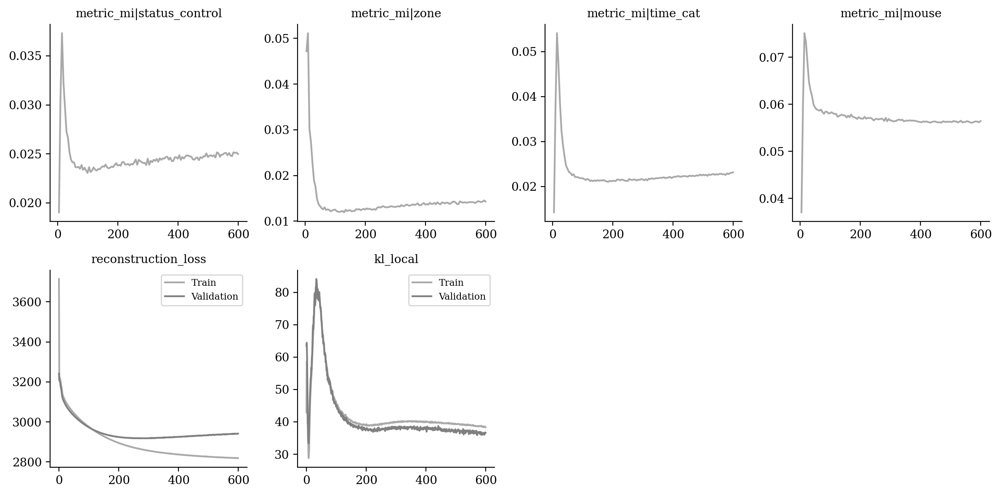

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

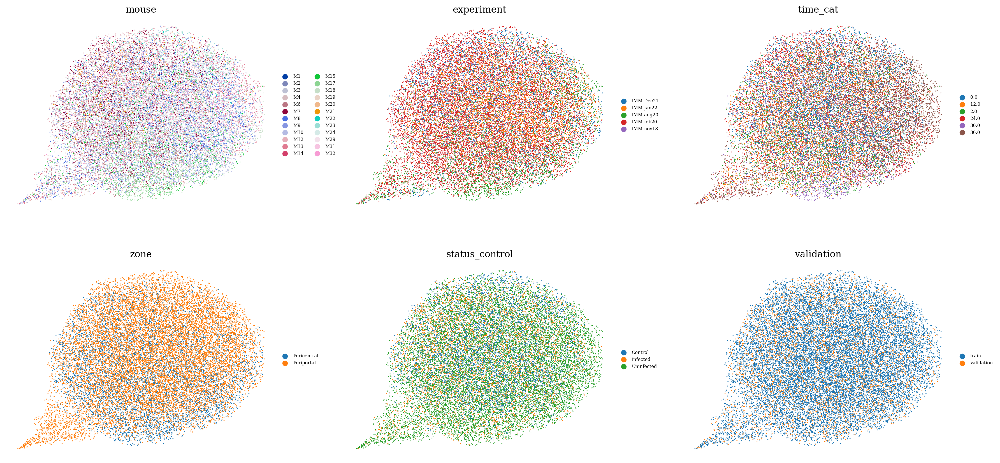

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

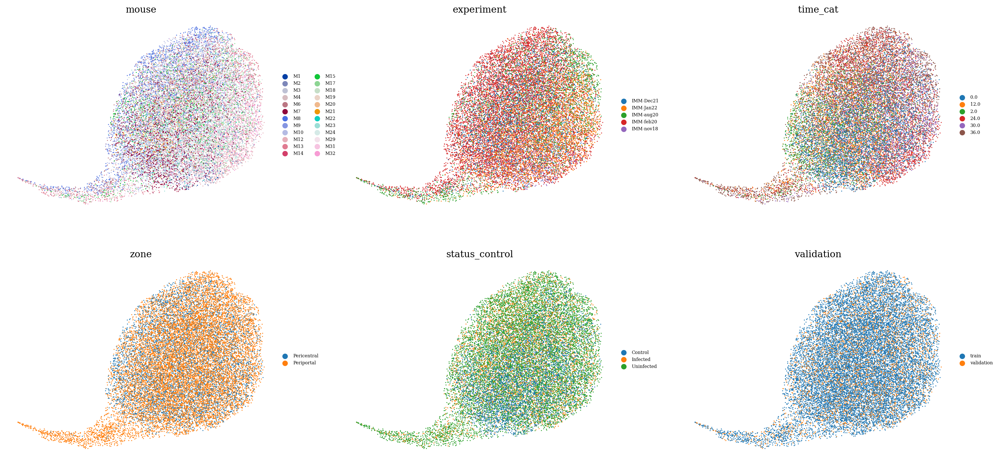

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

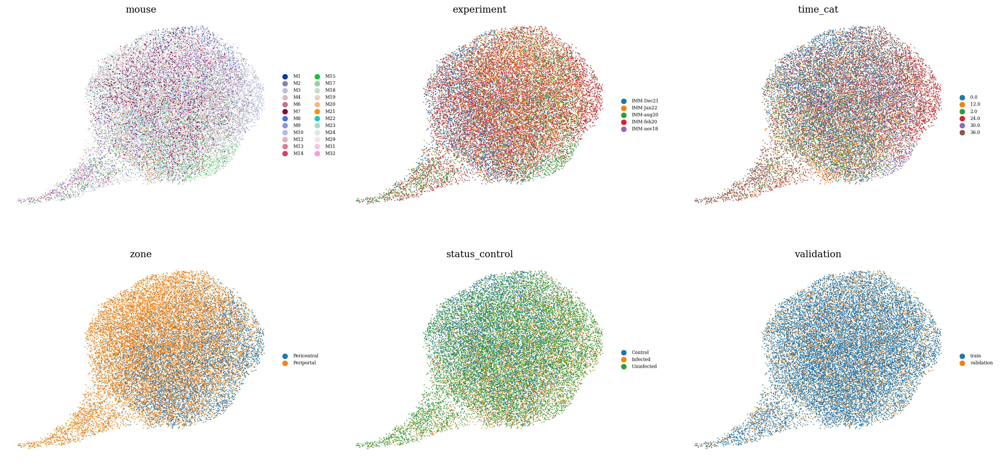

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

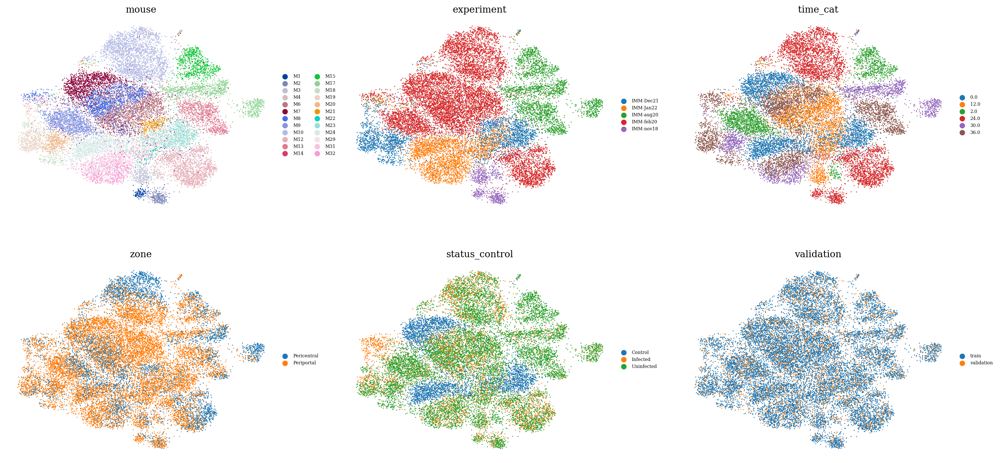

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

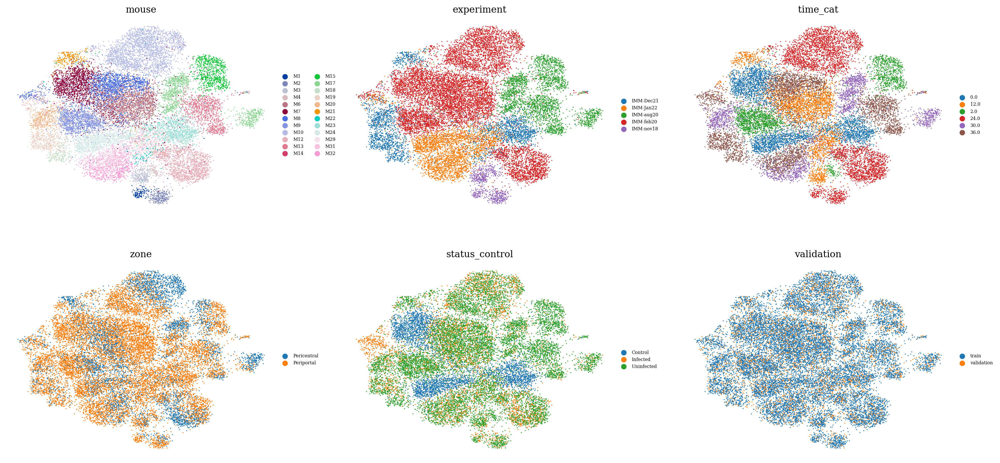

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

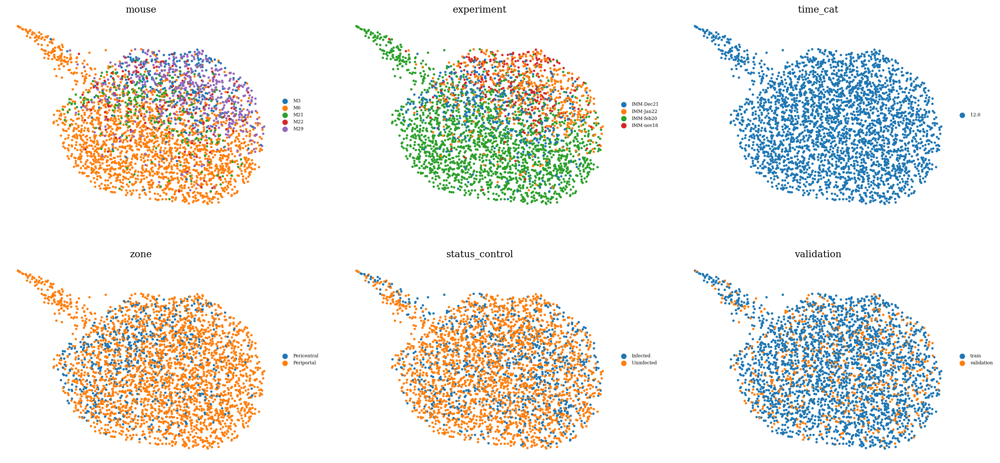

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )